# Дорогой дневник

--------------------------------------------

1) Сначала я решил попробовать без генерации новых фичей и без подкрутки параметров запустить LightGBM и посмотреть, что будет. Скор 0.720
При этом пока еще нет ни генерации новых признаков, ни использования таблицы поиска и тд. Попробуем добавить.

2) Просто запускаем код из "baseline_1_pandas.ipynb" и получаем обещаный скор 0.817

3) Оптюнил 10 минут, безрезультатно. Буду придумывать новые признаки. Думаю начать с кластеризации и knn. 

4) Сначала решил просто расширить плавающее окно с 4 до 5 месяцев, результат 0.8192.

    Есть огромное количество идей, только что заменил пандас на поларс, потому что он реально на порядок быстрее. В первую очередь хочется применить знания с семинара по интерпретации бустингов, но сначала заменить катбуст на lgbm, ибо Илья утверждал, что при должном обращении он рвет и мечет.

--------------------------------------------

In [ ]:
import polars as pl
import pandas as pd
import numpy as np
import catboost
import os
from datetime import date, timedelta
from local_utils import *
import lightgbm as lgb

%load_ext autoreload
%autoreload 2


In [1]:
test_start_date = date(2024, 8, 1)
val_start_date = date(2024, 7, 1)
val_end_date = date(2024, 7, 31)
train_end_date = date(2024, 6, 30)
data_path = "C:\\Users\\Admin\\Desktop\\AIM 2сем\\ML2\\hw2"

NameError: name 'date' is not defined

# Read data

In [ ]:
actions_history = pl.scan_parquet(os.path.join(data_path, 'actions_history/*.parquet')).collect()
search_history = pl.scan_parquet(os.path.join(data_path, 'search_history/*.parquet')).collect()
product_information = pl.read_csv(
    os.path.join(data_path, 'product_information.csv'),
    ignore_errors=True
)

In [ ]:
pl.read_csv(os.path.join(data_path, 'action_type_info.csv'))

action_type,action_type_id
str,i64
"""click""",1
"""favorite""",2
"""order""",3
"""search""",4
"""to_cart""",5
"""view""",6


In [ ]:
val_target = (
    actions_history
    .filter(pl.col('timestamp').dt.date() >= val_start_date)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .select('user_id', (pl.col('action_type_id') == 3).alias('has_order'))
    .group_by('user_id')
    .agg(pl.max('has_order').cast(pl.Int32).alias('target'))
)

In [ ]:
val_target.group_by('target').agg(pl.count('user_id'))

target,user_id
i32,u32
0,1227381
1,647575


# Simple pipeline

## Feats

In [ ]:
actions_aggs = {}
actions_id_to_suf = {
    1: "click",
    2: "favorite",
    3: "order",
    5: "to_cart",
}
for id_, suf in actions_id_to_suf.items():
    aggs = (
        actions_history
        .filter(pl.col('timestamp').dt.date() <= train_end_date)
        .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30 * 4))
        .filter(pl.col('action_type_id') == id_)
        .join(
            product_information
            .select('product_id', 'discount_price'),
            on='product_id',
        )
        .group_by('user_id')
        .agg(
            pl.count('product_id').cast(pl.Int32).alias(f'num_products_{suf}'),
            pl.sum('discount_price').cast(pl.Float32).alias(f'sum_discount_price_{suf}'),
            pl.max('discount_price').cast(pl.Float32).alias(f'max_discount_price_{suf}'),
            pl.max('timestamp').alias(f'last_{suf}_time'),
            pl.min('timestamp').alias(f'first_{suf}_time'),
        )
        .with_columns([
            (pl.lit(val_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),
            
            (pl.lit(val_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
        ])
        .select(
            'user_id',
            f'num_products_{suf}',
            f'sum_discount_price_{suf}',
            f'max_discount_price_{suf}',
            f'days_since_last_{suf}',
            f'days_since_first_{suf}',
        )
    )
    actions_aggs[id_] = aggs

In [ ]:
# search_aggs
id_ = 4
suf = 'search'
actions_aggs[id_] = (
    search_history
    .filter(pl.col('action_type_id') == id_)
    .filter(pl.col('timestamp').dt.date() <= train_end_date)
    .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30 * 4))
    .group_by('user_id')
    .agg(
        pl.count('search_query').cast(pl.Int32).alias(f'num_{suf}'),
        pl.max('timestamp').alias(f'last_{suf}_time'),
        pl.min('timestamp').alias(f'first_{suf}_time'),
    )
    .with_columns([
        (pl.lit(val_start_date) - pl.col(f'last_{suf}_time'))
        .dt.total_days()
        .cast(pl.Int32)
        .alias(f'days_since_last_{suf}'),

        (pl.lit(val_start_date) - pl.col(f'first_{suf}_time'))
        .dt.total_days()
        .cast(pl.Int32)
        .alias(f'days_since_first_{suf}'),
    ])
    .select(
        'user_id',
        f'num_{suf}',
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
    )
)

In [ ]:
actions_aggs.keys()

dict_keys([1, 2, 3, 5, 4])

In [ ]:
df = val_target
for _, actions_aggs_df in actions_aggs.items():
    df = (
        df
        .join(actions_aggs_df, on='user_id', how='left')
    )

In [ ]:
df

user_id,target,num_products_click,sum_discount_price_click,max_discount_price_click,days_since_last_click,days_since_first_click,num_products_favorite,sum_discount_price_favorite,max_discount_price_favorite,days_since_last_favorite,days_since_first_favorite,num_products_order,sum_discount_price_order,max_discount_price_order,days_since_last_order,days_since_first_order,num_products_to_cart,sum_discount_price_to_cart,max_discount_price_to_cart,days_since_last_to_cart,days_since_first_to_cart,num_search,days_since_last_search,days_since_first_search
i32,i32,i32,f32,f32,i32,i32,i32,f32,f32,i32,i32,i32,f32,f32,i32,i32,i32,f32,f32,i32,i32,i32,i32,i32
4414649,0,20,13833.0,1868.0,1,116,6,6922.0,3786.0,1,45,null,null,null,null,null,10,4152.0,900.0,1,45,9,1,96
6600543,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
4584152,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
8989878,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
2988255,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
882807,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
6396959,0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
4808258,0,13,2317.0,288.0,58,58,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,7,58,58


In [ ]:
df_pd = df.to_pandas()

In [ ]:
tr, val = get_split(df_pd, val_size=0.3)

In [ ]:
df_pd.columns

Index(['user_id', 'target', 'num_products_click', 'sum_discount_price_click',
       'max_discount_price_click', 'days_since_last_click',
       'days_since_first_click', 'num_products_favorite',
       'sum_discount_price_favorite', 'max_discount_price_favorite',
       'days_since_last_favorite', 'days_since_first_favorite',
       'num_products_order', 'sum_discount_price_order',
       'max_discount_price_order', 'days_since_last_order',
       'days_since_first_order', 'num_products_to_cart',
       'sum_discount_price_to_cart', 'max_discount_price_to_cart',
       'days_since_last_to_cart', 'days_since_first_to_cart', 'num_search',
       'days_since_last_search', 'days_since_first_search'],
      dtype='object')

In [ ]:
cols = [
    'num_products_click', 
    'sum_discount_price_click', 'max_discount_price_click',
    'days_since_last_click', 'days_since_first_click',
    'num_products_favorite', 'sum_discount_price_favorite',
    'max_discount_price_favorite', 'days_since_last_favorite',
    'days_since_first_favorite', 'num_products_order',
    'sum_discount_price_order', 'max_discount_price_order',
    'days_since_last_order', 'days_since_first_order',
    'num_products_to_cart', 'sum_discount_price_to_cart',
    'max_discount_price_to_cart', 'days_since_last_to_cart',
    'days_since_first_to_cart', 'num_search', 'days_since_last_search',
    'days_since_first_search'
]

In [ ]:
model = train_model(
    tr,
    val,
    features=cols,
    target_col='target',
    params={
        'objective': 'binary',
        'metric': 'auc',
        'learning_rate': 0.1,
        'max_depth': 7,
        'num_iterations': 200,
        'early_stopping_rounds': 50,
        'verbose': 10
    }
)

[LightGBM] [Warning] Provided parameters constrain tree depth (max_depth=7) without explicitly setting 'num_leaves'. This can lead to underfitting. To resolve this warning, pass 'num_leaves' (<=128) in params. Alternatively, pass (max_depth=-1) and just use 'num_leaves' to constrain model complexity.
[LightGBM] [Warning] Provided parameters constrain tree depth (max_depth=7) without explicitly setting 'num_leaves'. This can lead to underfitting. To resolve this warning, pass 'num_leaves' (<=128) in params. Alternatively, pass (max_depth=-1) and just use 'num_leaves' to constrain model complexity.
[LightGBM] [Info] Number of positive: 453534, number of negative: 858935
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.838965
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.345107
[LightGBM] [Debug] init for col-wise cost 0.013558 seconds, init for row-wise cost 0.065524 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the over

In [ ]:
name = 'baseline_1_lgb'
model.save_model(f"{name}.txt")

In [ ]:
fi = pd.DataFrame({
    'feature': model.feature_name(),
    'importance': model.feature_importance(importance_type='gain')
}).sort_values('importance', ascending=False)

fi.head(50)

,feature,importance
13,days_since_last_order,1.230845e+06
16,sum_discount_price_to_cart,1.898710e+05
10,num_products_order,1.020412e+05
11,sum_discount_price_order,6.157804e+04
20,num_search,2.331626e+04
17,max_discount_price_to_cart,2.301537e+04
14,days_since_first_order,2.197040e+04
15,num_products_to_cart,1.885469e+04
0,num_products_click,1.862233e+04
22,days_since_first_search,1.134987e+04


In [ ]:
test_users_submission = (
    pl.read_csv(os.path.join(data_path, 'test_users.csv'))
)

In [ ]:
actions_aggs = {}
actions_id_to_suf = {
    1: "click",
    2: "favorite",
    3: "order",
    5: "to_cart",
}
for id_, suf in actions_id_to_suf.items():
    aggs = (
        actions_history
        .filter(pl.col('timestamp').dt.date() <= val_end_date)
        .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30 * 4))
        .filter(pl.col('action_type_id') == id_)
        .join(
            product_information
            .select('product_id', 'discount_price'),
            on='product_id',
        )
        .group_by('user_id')
        .agg(
            pl.count('product_id').cast(pl.Int32).alias(f'num_products_{suf}'),
            pl.sum('discount_price').cast(pl.Float32).alias(f'sum_discount_price_{suf}'),
            pl.max('discount_price').cast(pl.Float32).alias(f'max_discount_price_{suf}'),
            pl.max('timestamp').alias(f'last_{suf}_time'),
            pl.min('timestamp').alias(f'first_{suf}_time'),
        )
        .with_columns([
            (pl.lit(test_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),
            
            (pl.lit(test_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
        ])
        .select(
            'user_id',
            f'num_products_{suf}',
            f'sum_discount_price_{suf}',
            f'max_discount_price_{suf}',
            f'days_since_last_{suf}',
            f'days_since_first_{suf}',
        )
    )
    actions_aggs[id_] = aggs

In [ ]:
# search_aggs
id_ = 4
suf = 'search'
actions_aggs[id_] = (
    search_history
    .filter(pl.col('action_type_id') == id_)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30 * 4))
    .group_by('user_id')
    .agg(
        pl.count('search_query').cast(pl.Int32).alias(f'num_{suf}'),
        pl.max('timestamp').alias(f'last_{suf}_time'),
        pl.min('timestamp').alias(f'first_{suf}_time'),
    )
    .with_columns([
        (pl.lit(test_start_date) - pl.col(f'last_{suf}_time'))
        .dt.total_days()
        .cast(pl.Int32)
        .alias(f'days_since_last_{suf}'),

        (pl.lit(test_start_date) - pl.col(f'first_{suf}_time'))
        .dt.total_days()
        .cast(pl.Int32)
        .alias(f'days_since_first_{suf}'),
    ])
    .select(
        'user_id',
        f'num_{suf}',
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
    )
)

In [ ]:
df = test_users_submission
for _, actions_aggs_df in actions_aggs.items():
    df = (
        df
        .join(actions_aggs_df, on='user_id', how='left')
    )

In [ ]:
df_pd = df.to_pandas()

In [ ]:
df_pd.shape

(2068424, 24)

In [ ]:
df_pd['predict'] = model.predict(df_pd[cols])

In [ ]:
df_pd[['user_id', 'predict']]

,user_id,predict
0,1342,0.187895
1,9852,0.797921
2,10206,0.223718
3,11317,0.216140
4,13289,0.600491
...,...,...
2068419,11157283,0.224649
2068420,11160395,0.139401
2068421,11165052,0.570314
2068422,11168218,0.498980


In [ ]:
df_pd[['user_id', 'predict']].to_csv('baseline_1_submission.csv', index=False)

In [ ]:
tr[cols].head(10)

,num_products_click,sum_discount_price_click,max_discount_price_click,days_since_last_click,days_since_first_click,num_products_favorite,sum_discount_price_favorite,max_discount_price_favorite,days_since_last_favorite,days_since_first_favorite,...,days_since_last_order,days_since_first_order,num_products_to_cart,sum_discount_price_to_cart,max_discount_price_to_cart,days_since_last_to_cart,days_since_first_to_cart,num_search,days_since_last_search,days_since_first_search
0,12.0,4795.0,1021.0,59.0,101.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,8.0,2267.0,499.0,59.0,101.0,10.0,59.0,101.0
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2.0,797.0,449.0,62.0,107.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,3.0,612.0,348.0,62.0,62.0,8.0,62.0,107.0
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,3.0,3341.0,2565.0,17.0,107.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,4.0,1528.0,419.0,17.0,57.0,9.0,3.0,109.0
8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,15.0,5894.0,792.0,39.0,49.0,4.0,2448.0,744.0,49.0,49.0,...,NaN,NaN,5.0,1528.0,704.0,39.0,39.0,7.0,39.0,56.0


In [ ]:
tr[cols].nunique()

num_products_click               1125
sum_discount_price_click       103251
max_discount_price_click         8759
days_since_last_click             121
days_since_first_click            122
num_products_favorite             380
sum_discount_price_favorite     21677
max_discount_price_favorite      5431
days_since_last_favorite          121
days_since_first_favorite         121
num_products_order                925
sum_discount_price_order        43575
max_discount_price_order         4734
days_since_last_order             121
days_since_first_order            121
num_products_to_cart             1339
sum_discount_price_to_cart      83447
max_discount_price_to_cart       5697
days_since_last_to_cart           121
days_since_first_to_cart          122
num_search                       1155
days_since_last_search            121
days_since_first_search           122
dtype: int64

In [ ]:
from IPython.display import display

display(get_df_info_new(tr[cols]).style.bar(subset=['nunique'], cmap="bwr"))

,datatype,nunique,nan,zero,empty_str,vc_max,vc_max_freq,example_1,example_2,trash_score
days_since_last_favorite,float64,122,n: 0.838,z: 0.003,-1,0.000000,n: 0.003,49.000000,38.000000,0.842
sum_discount_price_favorite,float32,21678,n: 0.838,z: 0.000,-1,299.000000,n: 0.001,2448.000000,1816.000000,0.839
max_discount_price_favorite,float32,5432,n: 0.839,-1,-1,299.000000,n: 0.001,744.000000,1816.000000,0.839
days_since_first_favorite,float64,122,n: 0.838,z: 0.001,-1,120.000000,n: 0.004,49.000000,38.000000,0.839
num_products_favorite,float64,381,n: 0.838,-1,-1,1.000000,n: 0.071,4.000000,1.000000,0.838
days_since_last_order,float64,122,n: 0.723,z: 0.019,-1,0.000000,n: 0.019,4.000000,27.000000,0.742
days_since_first_order,float64,122,n: 0.723,z: 0.003,-1,35.000000,n: 0.008,43.000000,27.000000,0.726
max_discount_price_order,float32,4735,n: 0.723,-1,-1,399.000000,n: 0.002,519.000000,399.000000,0.723
num_products_order,float64,926,n: 0.723,-1,-1,1.000000,n: 0.022,70.000000,21.000000,0.723
sum_discount_price_order,float32,43576,n: 0.723,z: 0.000,-1,379.000000,n: 0.000,12343.000000,2264.000000,0.723


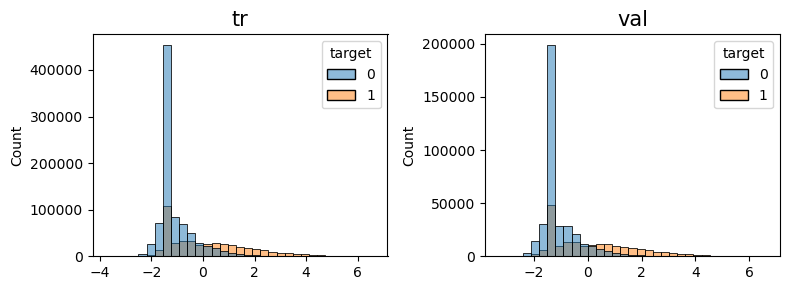

In [ ]:
plot_scores(model, tr[cols], tr.target, val[cols], val.target)

In [ ]:
#plot_scores(model, tr[cols], tr.target, val[cols], val.target, split_col='days_since_last_order')

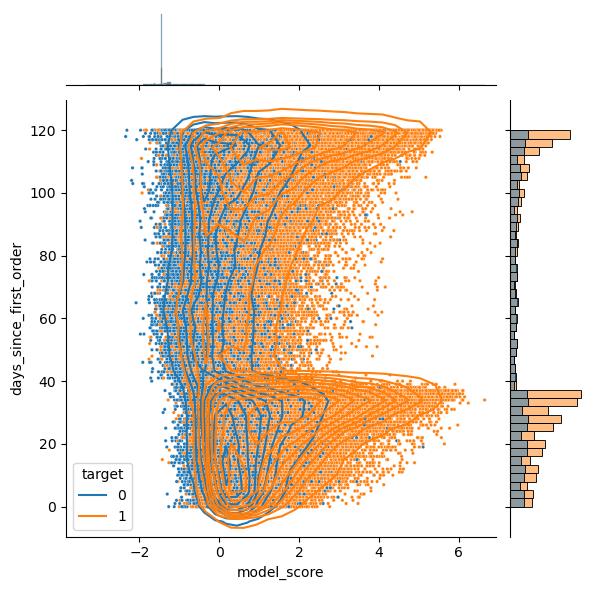

In [ ]:
plot_scores(model, tr[cols], tr.target, val[cols], val.target, support_col='days_since_first_order', support_log=False)

Вывод такой - Опираясь на количество дней с первого заказа часто лишний раз говорим, что таргет у пользователя 1, хотя на самом деле 0

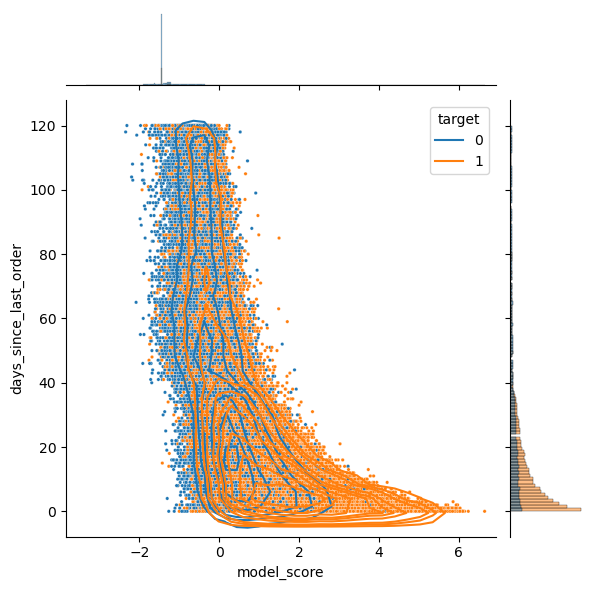

In [ ]:
plot_scores(model, tr[cols], tr.target, val[cols], val.target, support_col='days_since_last_order', support_log=False)

Нужно понимать так: начиная где то с 3 оранжевые отлично отделяются от синих, это супер. А вот левее каша, нам нехватает фичей. 

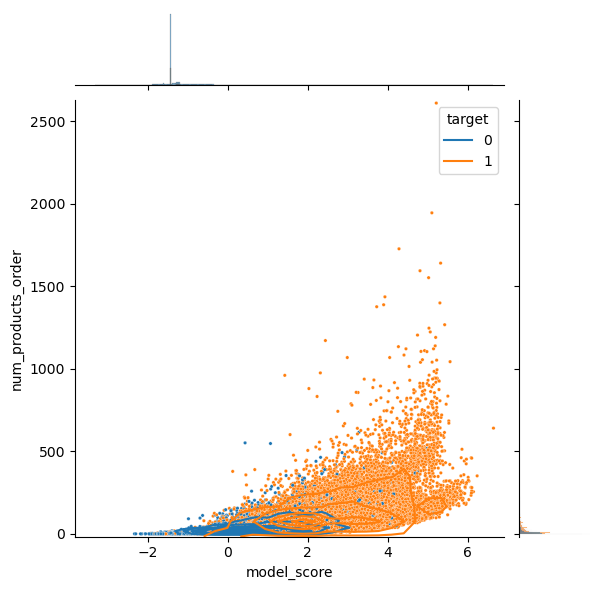

In [ ]:
plot_scores(model, tr[cols], tr.target, val[cols], val.target, support_col='num_products_order', support_log=False)

Очень плохо видно, но похоже что все +- неормально

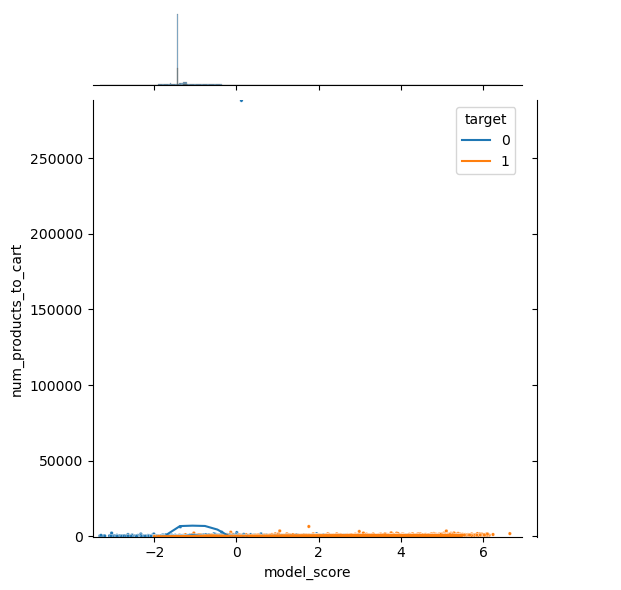

In [ ]:
plot_scores(model, tr[cols], tr.target, val[cols], val.target, support_col='num_products_to_cart', support_log=False)

Есть жесткий выбрас, нужно посмотреть что не так

In [ ]:
params={
        'objective': 'binary',
        'metric': 'auc',
        'learning_rate': 0.1,
        'max_depth': 7,
        'num_iterations': 200,
        'early_stopping_rounds': 50,
        'verbose': 10,
        'importance_type': 'split'
    }

model_with_rnd, shadow_features, tr_rnd, val_rnd = train_model(tr, val, cols, 'target', params=params, shadow_features=True, sklearn_style=True)
rnd_features = np.r_[cols, shadow_features]
shadow_features

[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Number of positive: 453534, number of negative: 858935
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.838965
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.242445
[LightGBM] [Debug] init for col-wise cost 0.012586 seconds, init for row-wise cost 0.065742 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032937 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 6711
[LightGBM] [Info] Number of data points in the train set: 1312469, number of used features: 38
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[L

Index(['shadow_float_1', 'shadow_float_2', 'shadow_float_3', 'shadow_float_4',
       'shadow_float_5', 'shadow_cat_big_1', 'shadow_cat_big_2',
       'shadow_cat_big_3', 'shadow_cat_big_4', 'shadow_cat_big_5',
       'shadow_cat_small_1', 'shadow_cat_small_2', 'shadow_cat_small_3',
       'shadow_cat_small_4', 'shadow_cat_small_5'],
      dtype='object')

feature_importance: [ 68   6  10  24  12  17   0   9   6   6  62  66  26 111  85  27  59  23
  17  25  66  24  31   0   0   0   0   0 181 153 185 168 153   0   0   0
   0   0] 



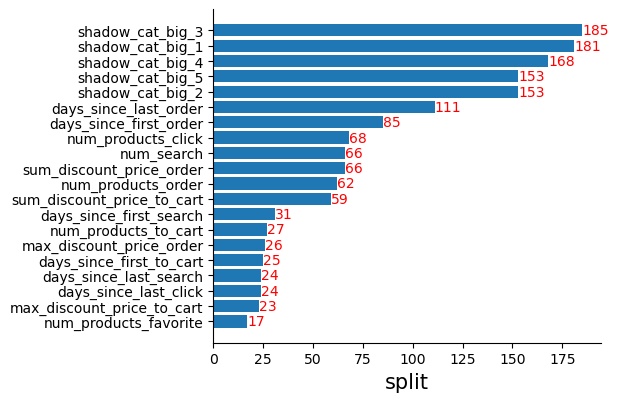

In [ ]:
from local_utils import *

print('feature_importance:', model_with_rnd.feature_importances_, '\n')

plot_lgbm_importance(model_with_rnd, rnd_features, importance_type='split', top_k=20, sklearn_style=True)

Видим что фейк фичи все забили

CPU times: total: 5min 36s
Wall time: 1min 14s


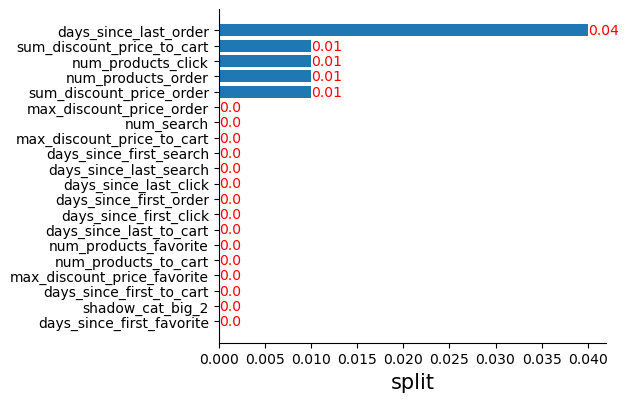

In [ ]:
%%time
from sklearn.inspection import permutation_importance


importance_dict = permutation_importance(model_with_rnd, val_rnd[rnd_features], val.target, scoring='roc_auc')
plot_lgbm_importance(model_with_rnd, rnd_features, importance_type='split', top_k=20, sklearn_style=True,
,                     imps=importance_dict['importances_mean'], round_to=2)

Более честная важность с перемешкой элементов внутри фичи - интересно что модель не прислушалась к фейк фичам, значит она вполне надежная и не есть что попало. 

А еще это значит что наши фичи вполне адекватные, пока что.

In [ ]:
model_cb = train_cb_model(tr, val, cols, 'target')
model_cb.save_model('cb_model.json', format='json')
import json

t = json.load(open('cb_model.json', 'r'))['oblivious_trees']
t

0:	test: 0.7446685	best: 0.7446685 (0)	total: 87.7ms	remaining: 43.7s
499:	test: 0.7573904	best: 0.7573916 (498)	total: 44.8s	remaining: 0us

bestTest = 0.7573915725
bestIteration = 498

Shrink model to first 499 iterations.


[{'leaf_values': [-0.014526871418455543,
   0.004825445969042904,
   0,
   0,
   0,
   0,
   0,
   0,
   -0.009793339416372822,
   0.006475191615488805,
   -0.011625981181844587,
   0.01676889628492089,
   0,
   0,
   0,
   0,
   -0.01738750419881078,
   0,
   0,
   0,
   0,
   0,
   0,
   0,
   -0.006371455256331234,
   0.011239188180447635,
   -0.005287254582960799,
   0.025518871772933965,
   0,
   0,
   0,
   0,
   -0.0017051276409877894,
   0.0028817310451924555,
   0,
   0,
   -0.00484844454917292,
   -0.0017165544662303908,
   0,
   0,
   -0.0005756036201069067,
   0.003425288852269286,
   -0.0006251705456305805,
   0.01026579237727808,
   -0.006156480831244444,
   -0.003070176175389998,
   -0.008504518145186097,
   -0.000363676432103119,
   -0.006928385818361476,
   -0.0029375699099448496,
   0,
   0,
   -0.011243850682856058,
   -0.005299911848249969,
   0,
   0,
   0.0023474909187060143,
   0.006831322403083658,
   0.008369534585560492,
   0.017186475123972957,
   -0.00272297

In [ ]:
t = model_with_rnd.booster_.trees_to_dataframe()
t

,tree_index,node_depth,node_index,left_child,right_child,parent_index,split_feature,split_gain,threshold,decision_type,missing_direction,missing_type,value,weight,count
0,0,1,0-S0,0-S1,0-S2,None,days_since_last_order,246037.000000,40.5,<=,right,NaN,-0.638623,296812.000000,1312469
1,0,2,0-S1,0-S5,0-S3,0-S0,sum_discount_price_to_cart,18762.500000,10953.5,<=,left,NaN,-0.470351,67214.000000,297213
2,0,3,0-S5,0-S10,0-S9,0-S1,num_products_order,2280.449951,7.5,<=,left,NaN,-0.527061,31231.900000,138104
3,0,4,0-S10,0-S22,0-L11,0-S5,sum_discount_price_to_cart,649.765991,3961.5,<=,left,NaN,-0.549993,18155.800000,80283
4,0,5,0-S22,0-L0,0-L23,0-S10,sum_discount_price_order,261.221008,1075.5,<=,left,NaN,-0.562608,12567.300000,55571
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3289,53,5,53-L2,None,None,53-S4,None,NaN,None,None,None,None,-0.138643,26.626176,401
3290,53,5,53-S5,53-L5,53-L6,53-S4,shadow_cat_big_1,61.100601,12||14||15||24||28||29||37||41||44||46||48||51...,==,right,NaN,0.010683,113.709000,1935
3291,53,6,53-L5,None,None,53-S5,None,NaN,None,None,None,None,-0.104336,24.781586,394
3292,53,6,53-L6,None,None,53-S5,None,NaN,None,None,None,None,0.050042,88.927569,1541


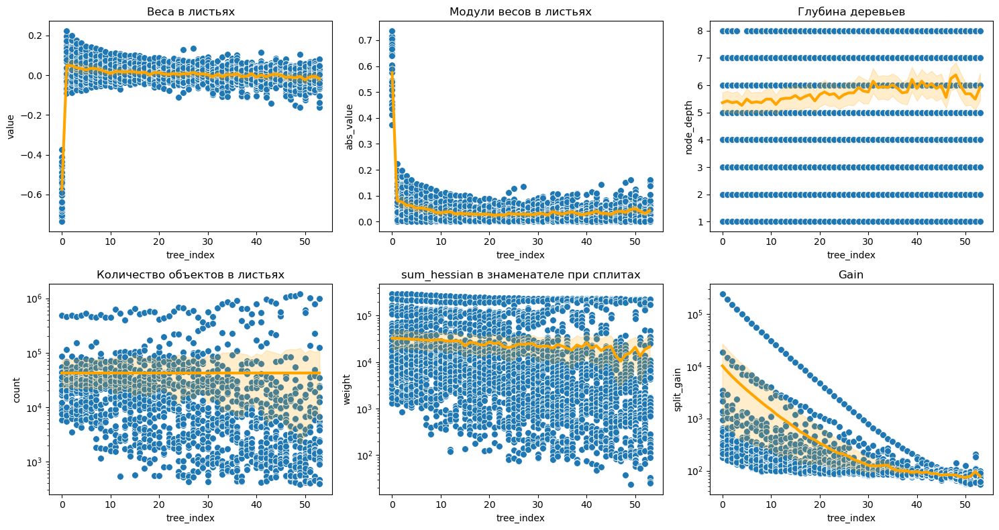

In [ ]:
plot_ensemble_profile(t)

In [ ]:
t.query('node_depth == 1').sample(15)

,tree_index,node_depth,node_index,left_child,right_child,parent_index,split_feature,split_gain,threshold,decision_type,missing_direction,missing_type,value,weight,count,abs_value
122,2,1,2-S0,2-S2,2-S1,None,days_since_last_order,153544.000000,44.5,<=,right,NaN,-2.294680e-04,294486.0,1312469,2.294680e-04
854,14,1,14-S0,14-S1,14-S2,None,days_since_last_order,14413.599609,33.5,<=,right,NaN,-1.059680e-04,256484.0,1312469,1.059680e-04
1525,25,1,25-S0,25-S2,25-S1,None,num_products_order,1900.069946,9.5,<=,left,NaN,-6.393280e-06,238007.0,1312469,6.393280e-06
1098,18,1,18-S0,18-S1,18-S2,None,days_since_last_order,6809.279785,27.5,<=,right,NaN,-5.021370e-05,247737.0,1312469,5.021370e-05
2745,45,1,45-S0,45-S1,45-S13,None,num_products_order,107.992996,170.5,<=,left,NaN,1.874700e-06,228977.0,1312469,1.874700e-06
2135,35,1,35-S0,35-S1,35-S2,None,days_since_last_order,360.811005,6.5,<=,right,NaN,5.836380e-06,231308.0,1312469,5.836380e-06
2684,44,1,44-S0,44-S1,44-S2,None,days_since_last_search,117.483002,2.5,<=,right,NaN,1.540420e-06,229115.0,1312469,1.540420e-06
3172,52,1,52-S0,52-S1,52-S2,None,num_search,59.607899,51.5,<=,left,NaN,-1.508540e-07,228172.0,1312469,1.508540e-07
1647,27,1,27-S0,27-S2,27-S1,None,sum_discount_price_order,1328.060059,3777.5,<=,left,NaN,-9.510650e-07,236083.0,1312469,9.510650e-07
61,1,1,1-S0,1-S2,1-S1,None,days_since_last_order,192779.000000,47.5,<=,right,NaN,-1.498400e-04,296233.0,1312469,1.498400e-04


Видим что days_since_last_order очень часто корень, это обьясняет график Gain. Самый верхний это как раз days_since_last_order, второй это наверно num_products_order. 

В очередной раз говорит об их важности. Файковых фичей снова не наблюдаем. Это значит, что модель вполне стабильная и можно делать фичи пости от балды, хуже не будет и ей можно доверять. 

Сделаю потом всякие перемножения и полиномиальные признаки 

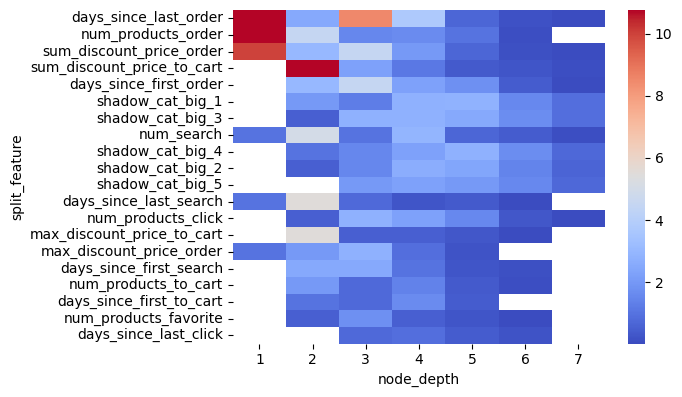

In [ ]:
from warnings import filterwarnings
filterwarnings('ignore')

plot_feature_depth(t, top_k=20)

Вот такое участие фичей на разных уровнях. В очередной раз видим знакоые фичи в топе. Число дней с последнего и первого поиска не очень то важны и не очень используются, но мне кажется логичным, что если человек делал много поиска в последнее время, то он что то да купит. 

Нужно двигаться в сторону числа запросов за последний день\неделю\две недели\месяц. 

Еще одна схожая идея в том, что если человек закупает последнее время продукты одной группы или часто их смотри, то логично что он купит. Тут нужнеа кластеризация. 

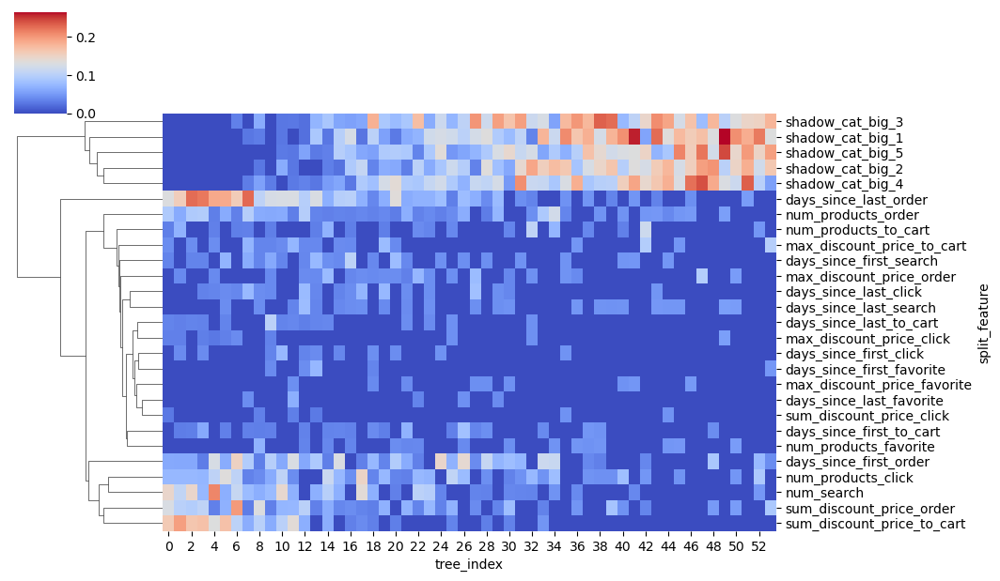

In [ ]:
activations = plot_feature_info(t, top_k=30, return_activations=True)

6-ой признак это days since last order. Мусорные фичи после 20го дерева обретают силу, а значит после 20го дерева модель переобучается и начинает сходить с ума. Также последние фичи важные

In [ ]:
activations.head(30)

tree_index,0,1,2,3,4,5,6,7,8,9,...,44,45,46,47,48,49,50,51,52,53
split_feature,,,,,,,,,,,,,,,,,,,,,
days_since_first_click,0.000000,0.040278,0.000000,0.039925,0.000000,0.000000,0.000000,0.000000,0.000000,0.034951,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
days_since_first_favorite,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.039947,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.047881
days_since_first_order,0.062139,0.060835,0.061137,0.030514,0.125702,0.064241,0.151492,0.094844,0.031811,0.098097,...,0.000000,0.000000,0.000000,0.000000,0.088867,0.000000,0.000000,0.000000,0.074750,0.041451
days_since_first_search,0.035008,0.000000,0.034888,0.034733,0.000000,0.069672,0.000000,0.064007,0.035928,0.061219,...,0.046945,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
days_since_first_to_cart,0.000000,0.030374,0.031205,0.062189,0.000000,0.032517,0.000000,0.033173,0.032044,0.032740,...,0.000000,0.000000,0.000000,0.000000,0.040947,0.000000,0.000000,0.000000,0.000000,0.000000
days_since_last_click,0.000000,0.000000,0.000000,0.033601,0.035514,0.039890,0.036521,0.075427,0.041051,0.039104,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
days_since_last_favorite,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.040674,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
days_since_last_order,0.131528,0.155975,0.225173,0.219621,0.188042,0.187494,0.157646,0.227539,0.104450,0.125200,...,0.000000,0.000000,0.041566,0.000000,0.000000,0.000000,0.000000,0.051061,0.000000,0.000000
days_since_last_search,0.000000,0.000000,0.000000,0.000000,0.000000,0.040653,0.000000,0.000000,0.041073,0.000000,...,0.046697,0.047664,0.000000,0.000000,0.000000,0.053508,0.051518,0.000000,0.000000,0.000000


Те фичи, у которых первые 5-7 колонок не нулевые очень важные, к ним стоит присмотреться и именно с ними стоит сроить новые комбинации. Хотя как я и сказал модель вполне стабильная и можно сделать полиномиальные фичи большой пачкой. 

In [ ]:
%%time
import umap
from umap import UMAP

mapper = UMAP(n_jobs=16, n_neighbors=3, metric='euclidean', a=1, b=0.9, random_state=1)
emb = mapper.fit_transform(activations)

import plotly.express as px

embs = pd.DataFrame({
    'x': emb[:, 0],
    'y': emb[:, 1],
    'feature': activations.index,
    'color': activations.max(axis=1)
})
px.scatter(data_frame=embs, x='x', y='y', hover_data='feature', color='color')

CPU times: total: 4.33 s
Wall time: 4.61 s


In [ ]:
leaf_matrix = model_with_rnd.booster_.predict(tr_rnd[rnd_features], pred_leaf=True)
object_leaf_attr = extract_attr_by_leaf_matrix(t, leaf_matrix, 'count')
object_leaf_attr

Это эмбединги на обьектах, можно предсказать лист. Потом на них построим график.

In [ ]:
n_objects = object_leaf_attr.shape[0]
sample_size = int(n_objects * 0.1)  # 10% от общего количества
print(f"Всего объектов: {n_objects}, будем использовать: {sample_size}")

Всего объектов: 1312469, будем использовать: 131246


In [ ]:
import numpy as np
import pandas as pd
import umap
import plotly.express as px
import seaborn as sns

# Проверяем тип данных
print(f"Тип object_leaf_attr: {type(object_leaf_attr)}")

# Если это numpy array - преобразуем в DataFrame
if isinstance(object_leaf_attr, np.ndarray):
    object_leaf_attr = pd.DataFrame(object_leaf_attr)

# Получаем 10% случайной выборки
n_objects = len(object_leaf_attr)
sample_size = int(n_objects * 0.1)  # 10% выборка
print(f"Всего объектов: {n_objects}, выборка: {sample_size}")

Тип object_leaf_attr: <class 'pandas.core.frame.DataFrame'>
Всего объектов: 1312469, выборка: 131246


In [ ]:

# Случайная выборка индексов
np.random.seed(1)
sample_indices = np.random.choice(object_leaf_attr.index, size=sample_size, replace=False)
sample_data = object_leaf_attr.loc[sample_indices]

# UMAP с автоматическим подбором n_neighbors
n_neighbors = min(30, sample_size//2)
mapper = umap.UMAP(
    n_neighbors=n_neighbors,
    metric='euclidean',
    random_state=1,
    n_jobs=16
)

In [ ]:
emb = mapper.fit_transform(sample_data)


SystemError: CPUDispatcher(<function nn_descent at 0x000001E037117420>) returned a result with an exception set

In [ ]:
embs = pd.DataFrame({
    'x': emb[:, 0],
    'y': emb[:, 1],
    'color': np.median(sample_data, axis=1)
})
fig = px.scatter(embs, x='x', y='y', color='color')
fig.update_layout(width=800)
fig.show()

In [ ]:
'''%%time
mapper = umap.UMAP(n_jobs=16, n_neighbors=30, metric='euclidean', random_state=1)
emb = mapper.fit_transform(object_leaf_attr)

embs = pd.DataFrame({
    'x': emb[:, 0],
    'y': emb[:, 1],
    'color': np.median(object_leaf_attr, axis=1)
})
fig = px.scatter(data_frame=embs, x='x', y='y', color='color')
fig.update_layout(width=800)'''

Тип object_leaf_attr: <class 'numpy.ndarray'>
Всего объектов: 1312469, выборка: 131246


KeyboardInterrupt: 

In [ ]:
#sns.clustermap(object_leaf_attr, robust=True, col_cluster=False, cmap='coolwarm')
# y_raw_tr = model_with_rnd.predict(tr_rnd[rnd_features])
# idx = np.argsort(y_raw_tr)
# sns.heatmap(object_leaf_attr[idx], cmap='coolwarm')

In [ ]:
import shap

explainer = shap.TreeExplainer(model_with_rnd)
shap_values = explainer(val_rnd[rnd_features])
print('features shape:', rnd_features.shape)

print('\n\nshap values structure:')
print('.values:', shap_values.values.shape, '.base_values:', shap_values.base_values.shape, '.data:', shap_values.data.shape)
shap_values # .values - shap values, .base_values - EF(X)=среднее_предсказание, .data - наши данные

features shape: (38,)


shap values structure:
.values: (562487, 38) .base_values: (562487,) .data: (562487, 38)


.values =
array([[-1.56426140e-01,  5.13762037e-04,  1.63492126e-02, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 5.35237112e-02,  6.14167122e-03, -2.62936476e-03, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 4.06145512e-02,  1.19494917e-04,  2.39725301e-03, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       ...,
       [ 4.10333608e-02,  2.14120700e-03,  2.20534113e-03, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 4.23297813e-02,  1.13483510e-03,  2.26771857e-03, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
       [ 4.27530191e-02,  2.08583784e-03,  2.62007988e-04, ...,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00]])

.base_values =
array([-0.68034305, -0.68034305, -0.68034305, ..., -0.68034305,
       -0.68034305, -0.68034305])

.data =
array([[20.0, 13833.0, 1868.0, ..., '0', '0', '0'],
       [1.0, 1094.0, 1094.0, ..., '2', '0', '2'],
       [

In [ ]:
pretty_print(dir(shap_values))

['__add__', '__class__', '__copy__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', 
	'__format__', '__ge__', '__getattribute__', '__getitem__', '__getstate__', '__gt__', 
	'__hash__', '__init__', '__init_subclass__', '__le__', '__len__', '__lt__', '__module__', 
	'__mul__', '__ne__', '__new__', '__radd__', '__reduce__', '__reduce_ex__', '__repr__', 
	'__rmul__', '__rsub__', '__setattr__', '__sizeof__', '__str__', '__sub__', '__subclasshook__', 
	'__truediv__', '__weakref__', '_apply_binary_operator', '_flatten_feature_names', 
	'_numpy_func', '_s', '_use_data_as_feature_names', 'abs', 'argsort', 'base_values', 
	'clustering', 'cohorts', 'compute_time', 'data', 'display_data', 'error_std', 'feature_names', 
	'flip', 'hclust', 'hierarchical_values', 'hstack', 'identity', 'instance_names', 
	'lower_bounds', 'main_effects', 'max', 'mean', 'min', 'op_history', 'output_dims', 
	'output_indexes', 'output_names', 'percentile', 'sample', 'shape', 'sum', 'upper_bounds', 
	'values']


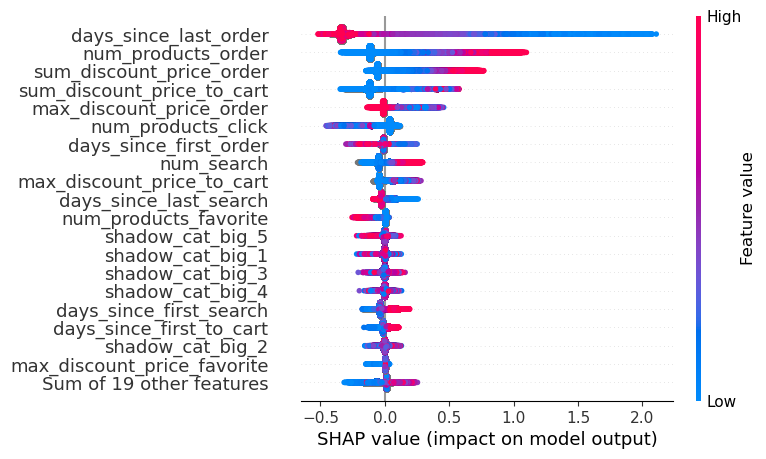

In [ ]:
shap.plots.beeswarm(shap_values, max_display=20, order=shap.Explanation.abs.max(0), plot_size=(6, 5))

Мне кажется что число дней с последнего заказа не совсем адекватно, это было видно и на самых первых графиках. Если дней мало, то этот признак дество перетягивает таргет в сторону 1 и естественно начинает быть через чур сужественным в принятии решения. Хотя даже логически понятно, что если человек купил продукт вчера, то наверно в ближайшие дни он не купит ничего, он уже удовлетворил свою потребность, запишнув все в одну корзину, а если у него даже на следующий день появиться новая, то он ее отложит на потом. 


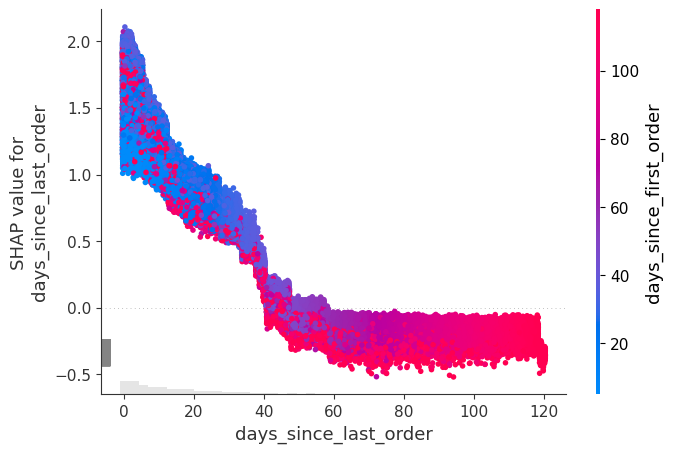

In [ ]:
shap.plots.scatter(shap_values[:, 'days_since_last_order'], color=shap_values, x_jitter=0.7)

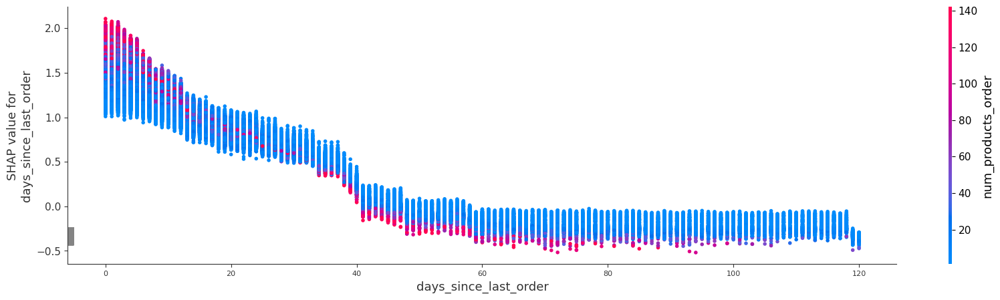

In [ ]:
shap.dependence_plot('days_since_last_order', shap_values.values, features=val_rnd, interaction_index='num_products_order', show=False)
plt.gca().tick_params('x', labelsize=8)
plt.gcf().set_size_inches(20, 5)

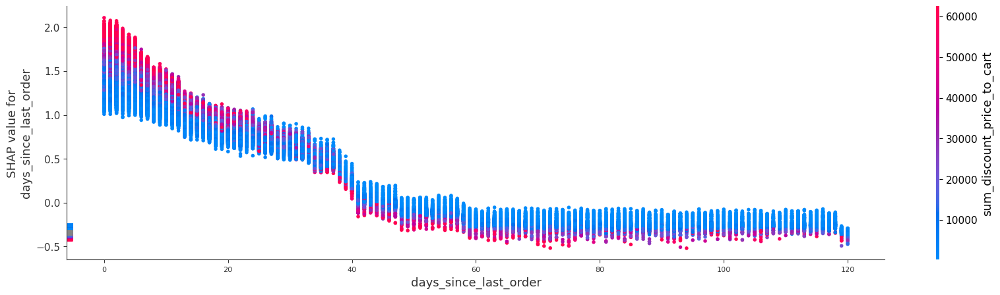

In [ ]:
shap.dependence_plot('days_since_last_order', shap_values.values, features=val_rnd, interaction_index='sum_discount_price_to_cart', show=False)
plt.gca().tick_params('x', labelsize=8)
plt.gcf().set_size_inches(20, 5)

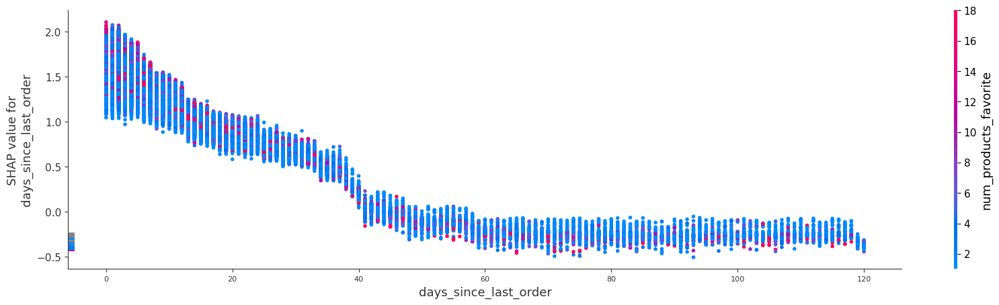

In [ ]:
shap.dependence_plot('days_since_last_order', shap_values.values, features=val_rnd, interaction_index='num_products_favorite', show=False)
plt.gca().tick_params('x', labelsize=8)
plt.gcf().set_size_inches(20, 5)

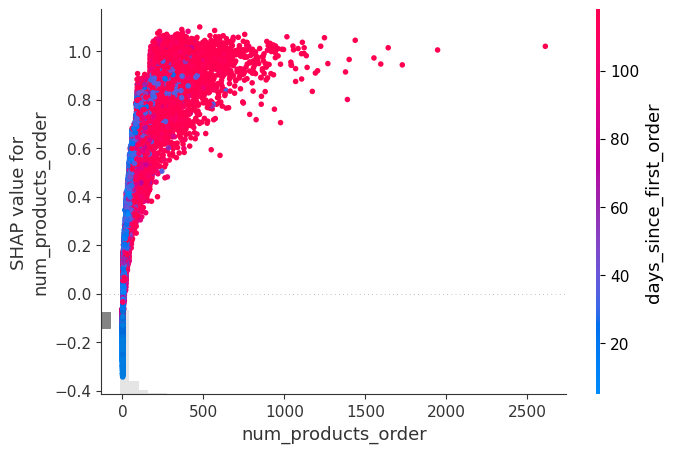

In [ ]:
shap.plots.scatter(shap_values[:, 'num_products_order'], color=shap_values, x_jitter=0.7)

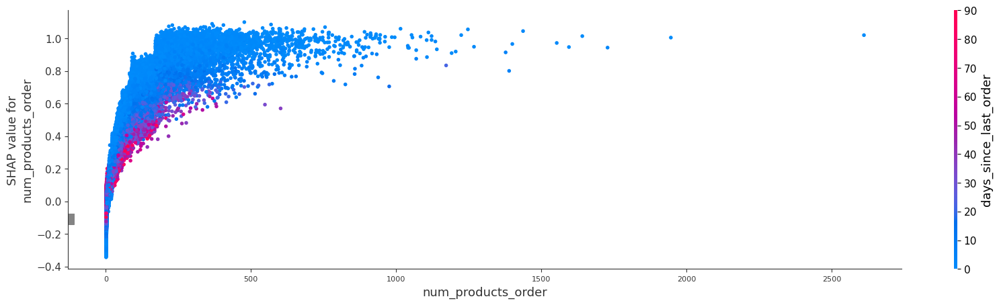

In [ ]:
shap.dependence_plot('num_products_order', shap_values.values, features=val_rnd, interaction_index='days_since_last_order', show=False)
plt.gca().tick_params('x', labelsize=8)
plt.gcf().set_size_inches(20, 5)

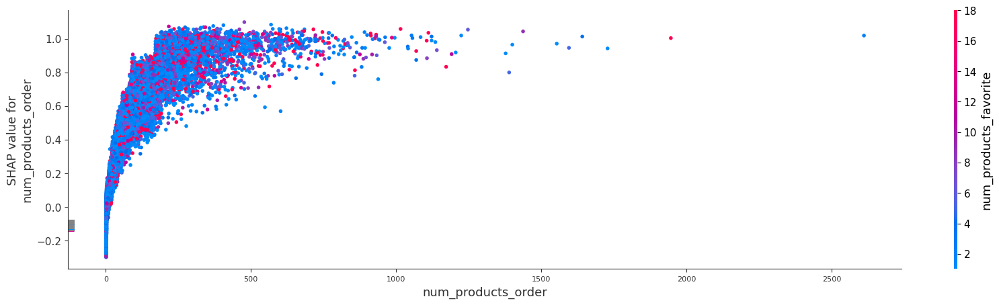

In [ ]:
shap.dependence_plot('num_products_order', shap_values.values, features=val_rnd, interaction_index='num_products_favorite', show=False)
plt.gca().tick_params('x', labelsize=8)
plt.gcf().set_size_inches(20, 5)

In [ ]:
shap.initjs()
shap.plots.force(shap_values[:300])

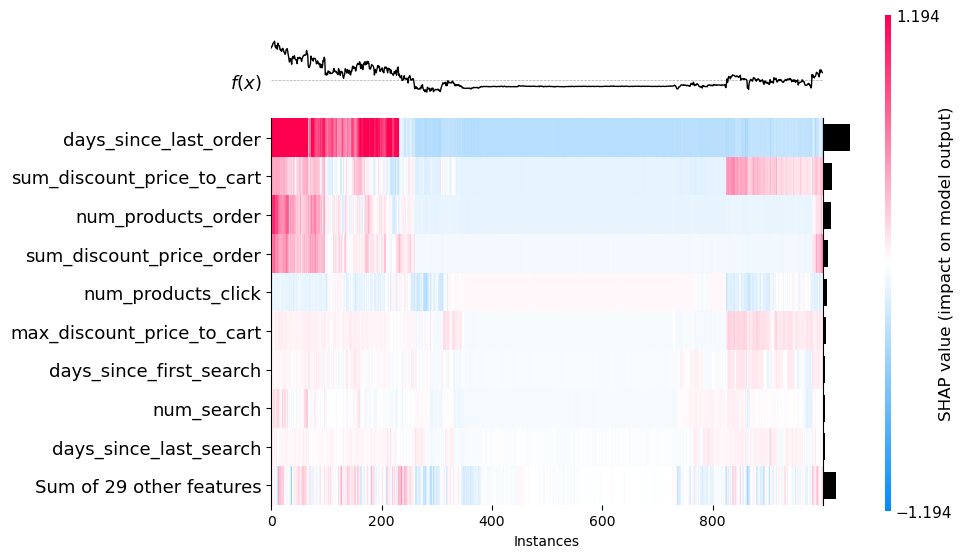

<Axes: xlabel='Instances'>

In [ ]:
shap.plots.heatmap(shap_values[:1000])

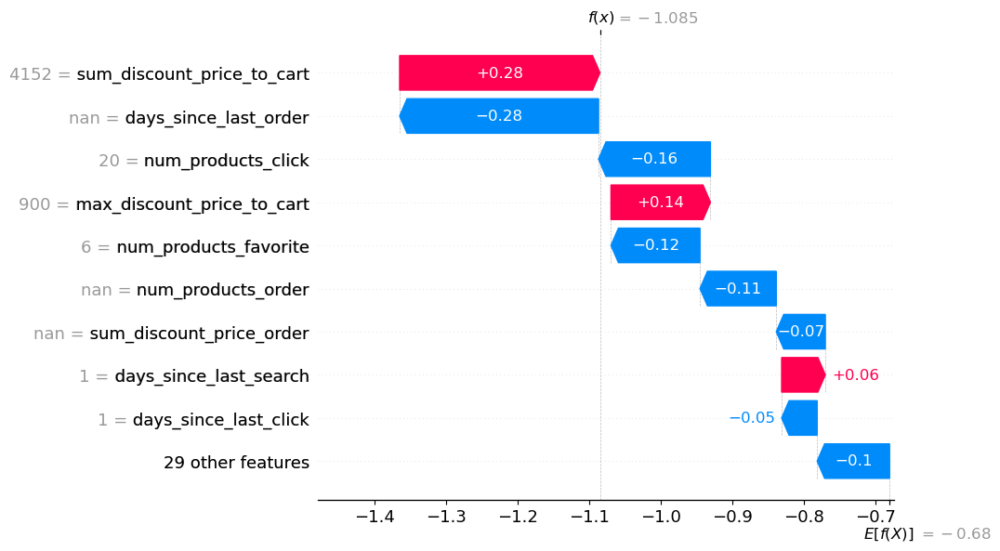

In [ ]:
shap.plots.waterfall(shap_values[0])

In [ ]:
%%time
from local_utils import *
import catboost as cb

explainer = shap.TreeExplainer(model_cb)
val_pool = cb.Pool(val_rnd[rnd_features], val.target, cat_features=val_rnd[rnd_features].select_dtypes('category').columns.to_list())
shap_interaction_values = explainer.shap_interaction_values(val_pool)
print(shap_interaction_values.shape)
shap_interaction_values[:2]

(562487, 38, 38)
CPU times: total: 56min 4s
Wall time: 6min 23s


array([[[-3.69531236e-02,  4.82863936e-05,  5.10661686e-04, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 4.82863936e-05,  2.00380084e-02,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 5.10661686e-04,  0.00000000e+00,  8.44008412e-03, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        ...,
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00]],

       [[-4.31956635e-02,  4.79408779e-05,  2.77050218e-04, ...,
          0.00000000e+00,  0.00000000e+00,  0.00000000e+00],
        [ 4.79408779e-05, -1.18983129e-02,  0.00000000e+00, ...,
          0.00000000e+00,  0.00000000e

<Figure size 640x480 with 0 Axes>

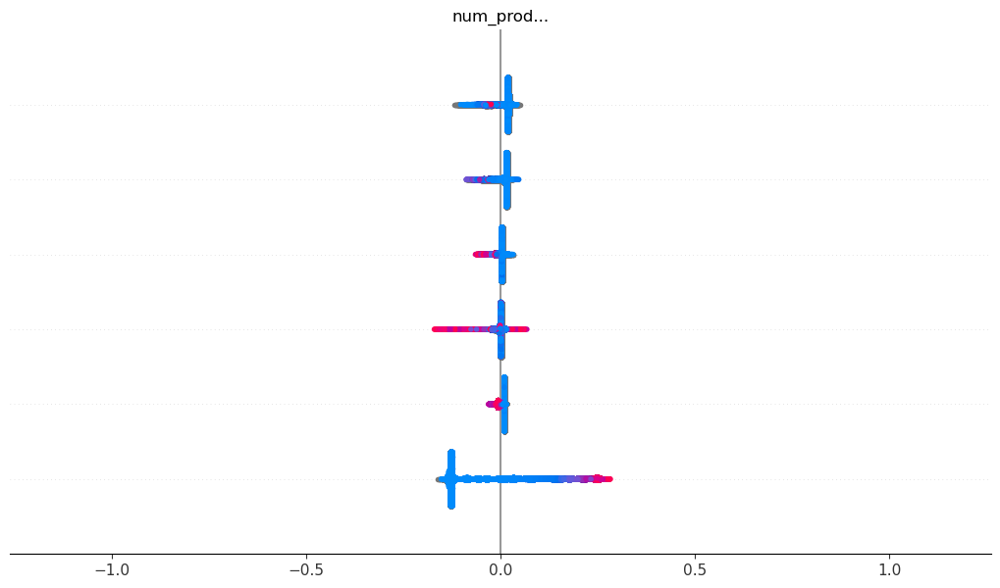

In [ ]:
shap.summary_plot(shap_interaction_values, max_display=6, features=val_rnd)

# Данные и их анализ
Теперь нужно оценить данные на выбросы и пропуски.

Возможно следовало сделать это с самого начала, но мне кажется, что после понимания того, какие есть слабые места у модели, оценить данные на пропуски получится лучше.

In [ ]:
import polars as pl
import pandas as pd
import numpy as np
import catboost
import os
from datetime import date, timedelta
from local_utils import *
import lightgbm as lgb

%load_ext autoreload
%autoreload 2

test_start_date = date(2024, 8, 1)
val_start_date = date(2024, 7, 1)
val_end_date = date(2024, 7, 31)
train_end_date = date(2024, 6, 30)
data_path = "C:\\Users\\Admin\\Desktop\\AIM 2сем\\ML2\\hw2"

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
actions_history = pl.scan_parquet(os.path.join(data_path, 'actions_history/*.parquet')).collect()
search_history = pl.scan_parquet(os.path.join(data_path, 'search_history/*.parquet')).collect()
product_information = pl.read_csv(
    os.path.join(data_path, 'product_information.csv'),
    ignore_errors=True
)

val_target = (
    actions_history
    .filter(pl.col('timestamp').dt.date() >= val_start_date)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .select('user_id', (pl.col('action_type_id') == 3).alias('has_order'))
    .group_by('user_id')
    .agg(pl.max('has_order').cast(pl.Int32).alias('target'))
)

In [ ]:
act_analyse = actions_history.to_pandas()

In [ ]:
build_my_info_table(act_analyse)

KeyboardInterrupt: 

In [ ]:
val_target.group_by('target').agg(pl.count('user_id'))

target,user_id
i32,u32
0,1227381
1,647575


In [ ]:
actions_aggs = {}
actions_id_to_suf = {
    1: "click",
    2: "favorite",
    3: "order",
    5: "to_cart",
}
for id_, suf in actions_id_to_suf.items():
    aggs = (
        actions_history
        .filter(pl.col('timestamp').dt.date() <= train_end_date)
        .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30 * 4))
        .filter(pl.col('action_type_id') == id_)
        .join(
            product_information
            .select('product_id', 'discount_price'),
            on='product_id',
        )
        .group_by('user_id')
        .agg(
            pl.count('product_id').cast(pl.Int32).alias(f'num_products_{suf}'),
            pl.sum('discount_price').cast(pl.Float32).alias(f'sum_discount_price_{suf}'),
            pl.max('discount_price').cast(pl.Float32).alias(f'max_discount_price_{suf}'),
            pl.max('timestamp').alias(f'last_{suf}_time'),
            pl.min('timestamp').alias(f'first_{suf}_time'),
        )
        .with_columns([
            (pl.lit(val_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),
            
            (pl.lit(val_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
        ])
        .select(
            'user_id',
            f'num_products_{suf}',
            f'sum_discount_price_{suf}',
            f'max_discount_price_{suf}',
            f'days_since_last_{suf}',
            f'days_since_first_{suf}',
        )
    )
    actions_aggs[id_] = aggs
# search_aggs
id_ = 4
suf = 'search'
actions_aggs[id_] = (
    search_history
    .filter(pl.col('action_type_id') == id_)
    .filter(pl.col('timestamp').dt.date() <= train_end_date)
    .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30 * 4))
    .group_by('user_id')
    .agg(
        pl.count('search_query').cast(pl.Int32).alias(f'num_{suf}'),
        pl.max('timestamp').alias(f'last_{suf}_time'),
        pl.min('timestamp').alias(f'first_{suf}_time'),
    )
    .with_columns([
        (pl.lit(val_start_date) - pl.col(f'last_{suf}_time'))
        .dt.total_days()
        .cast(pl.Int32)
        .alias(f'days_since_last_{suf}'),

        (pl.lit(val_start_date) - pl.col(f'first_{suf}_time'))
        .dt.total_days()
        .cast(pl.Int32)
        .alias(f'days_since_first_{suf}'),
    ])
    .select(
        'user_id',
        f'num_{suf}',
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
    )
)

In [ ]:
df = val_target
for _, actions_aggs_df in actions_aggs.items():
    df = (
        df
        .join(actions_aggs_df, on='user_id', how='left')
    )

In [ ]:
df_topd = df.to_pandas()

In [ ]:
df_topd.columns

Index(['user_id', 'target', 'num_products_click', 'sum_discount_price_click',
       'max_discount_price_click', 'days_since_last_click',
       'days_since_first_click', 'num_products_favorite',
       'sum_discount_price_favorite', 'max_discount_price_favorite',
       'days_since_last_favorite', 'days_since_first_favorite',
       'num_products_order', 'sum_discount_price_order',
       'max_discount_price_order', 'days_since_last_order',
       'days_since_first_order', 'num_products_to_cart',
       'sum_discount_price_to_cart', 'max_discount_price_to_cart',
       'days_since_last_to_cart', 'days_since_first_to_cart', 'num_search',
       'days_since_last_search', 'days_since_first_search'],
      dtype='object')

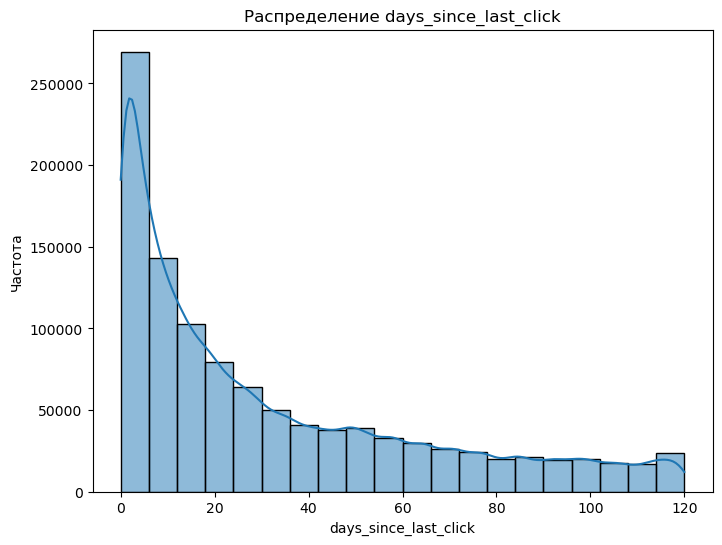

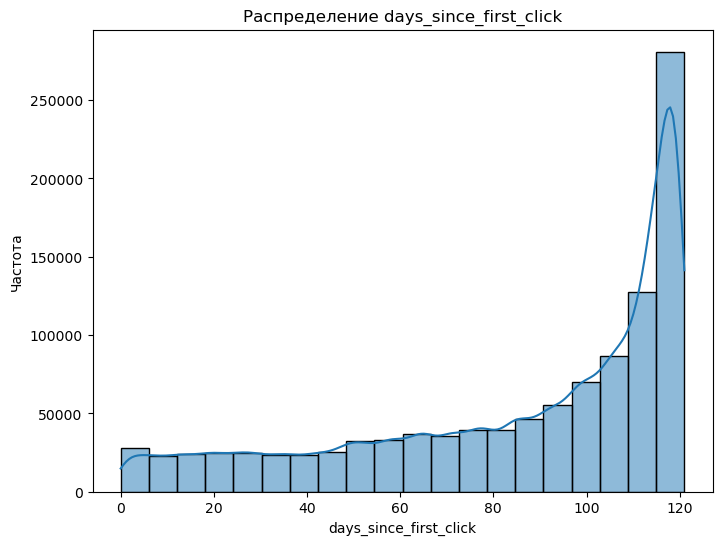

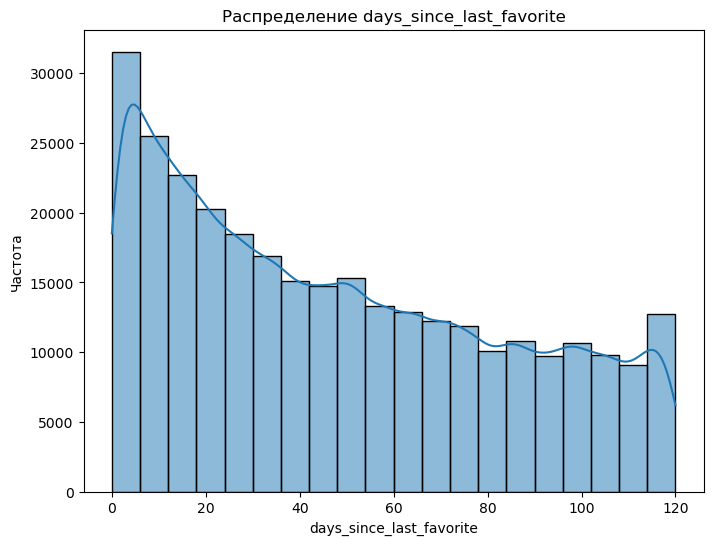

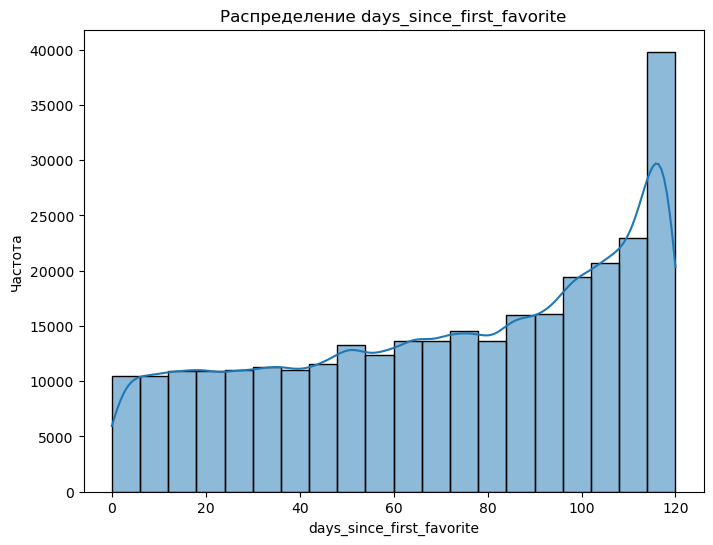

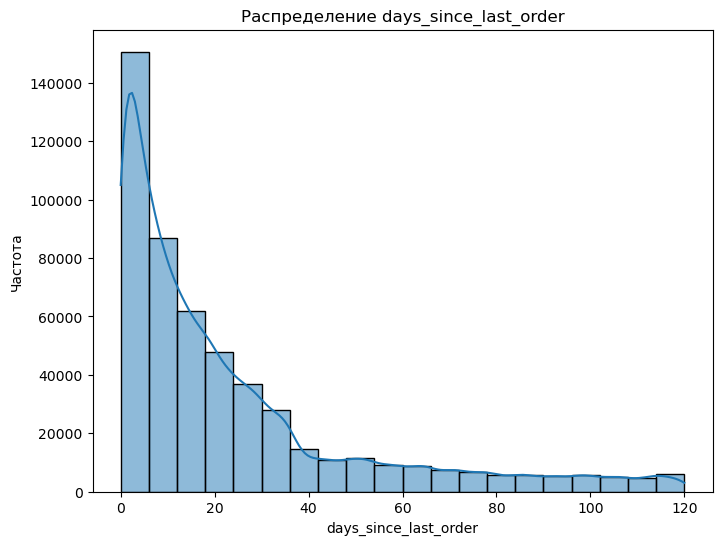

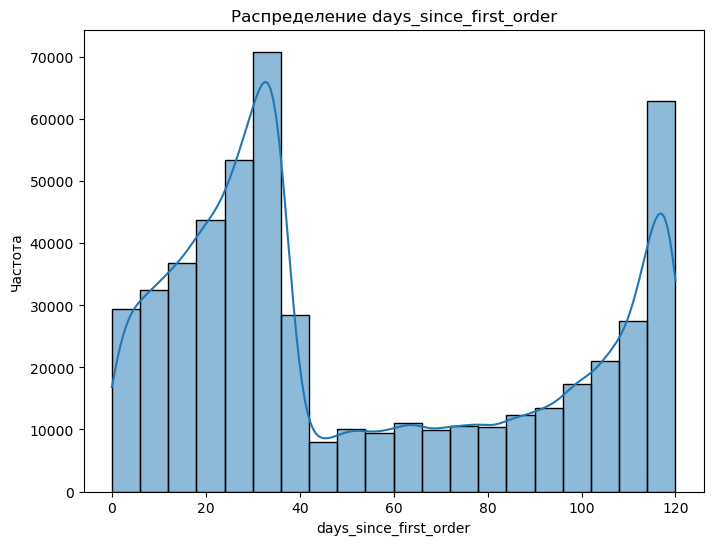

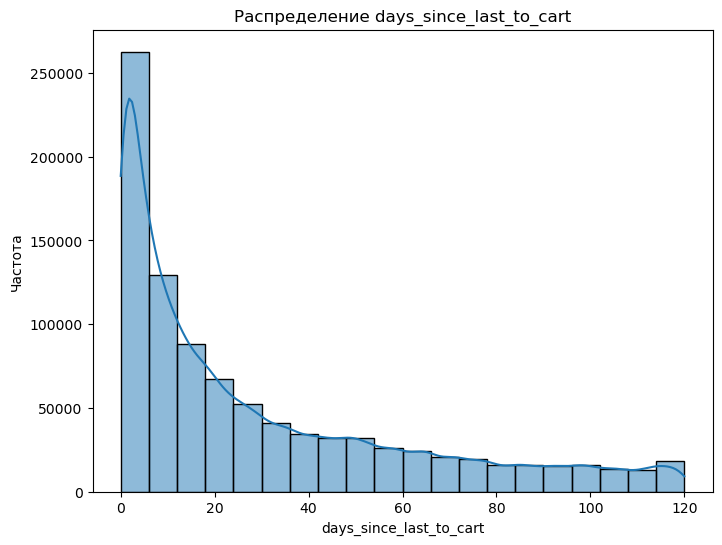

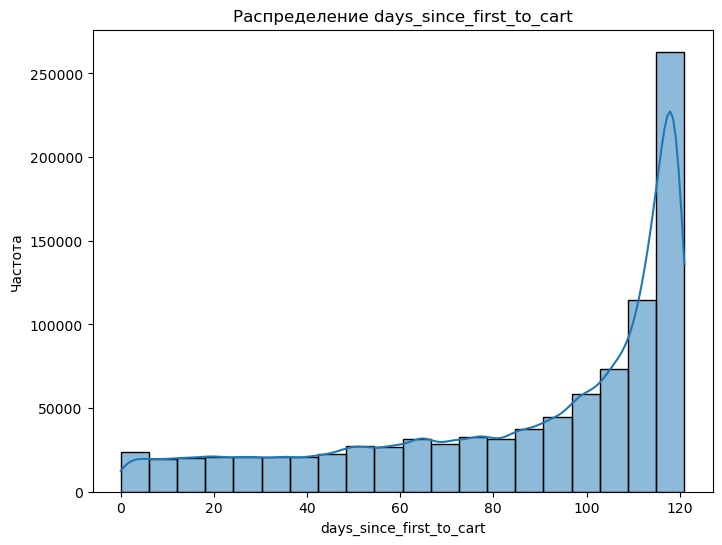

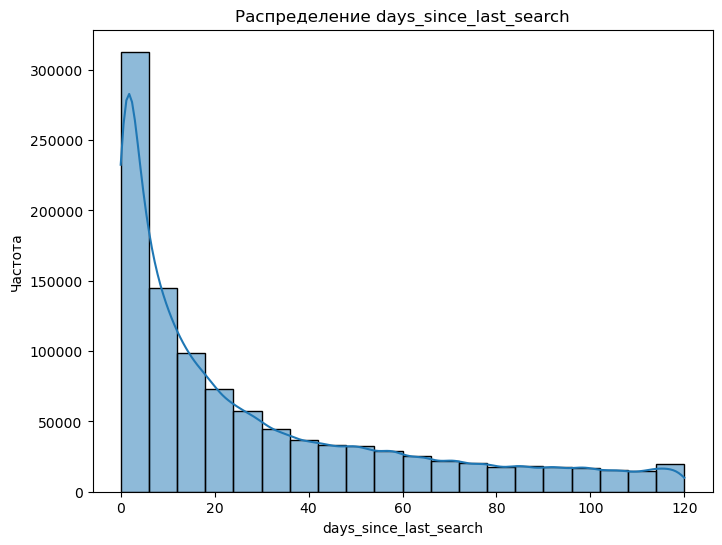

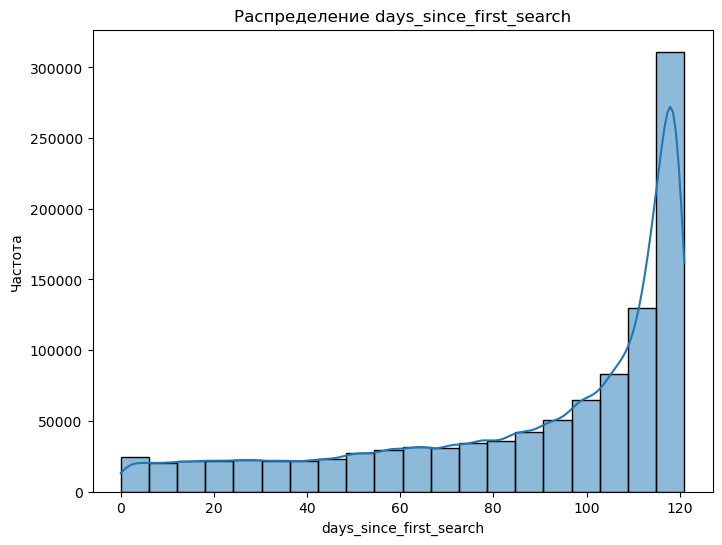

In [ ]:
cols = ['days_since_last_click',
       'days_since_first_click', 'days_since_last_favorite', 'days_since_first_favorite', 'days_since_last_order',
       'days_since_first_order', 'days_since_last_to_cart', 'days_since_first_to_cart', 'days_since_last_search', 'days_since_first_search']

for col in cols:
    plt.figure(figsize=(8, 6))
    sns.histplot(df_topd[col], bins=20, kde=True)
    plt.title(f'Распределение {col}')
    plt.xlabel(f'{col}')
    plt.ylabel('Частота')
    plt.show()

In [ ]:
from IPython.display import display

display(get_df_info_new(df_topd).style.bar(subset=['nunique'], cmap="bwr"))

,datatype,nunique,nan,zero,empty_str,vc_max,vc_max_freq,example_1,example_2,trash_score
days_since_last_favorite,float64,122,n: 0.838,z: 0.003,-1,0.000000,n: 0.003,45.000000,19.000000,0.841
days_since_first_favorite,float64,122,n: 0.838,z: 0.001,-1,120.000000,n: 0.004,45.000000,19.000000,0.839
sum_discount_price_favorite,float32,25497,n: 0.838,z: 0.000,-1,299.000000,n: 0.001,704.000000,740.000000,0.838
max_discount_price_favorite,float32,5865,n: 0.838,-1,-1,299.000000,n: 0.001,704.000000,740.000000,0.838
num_products_favorite,float64,436,n: 0.838,-1,-1,1.000000,n: 0.071,1.000000,5.000000,0.838
days_since_last_order,float64,122,n: 0.723,z: 0.019,-1,0.000000,n: 0.019,44.000000,26.000000,0.742
days_since_first_order,float64,122,n: 0.723,z: 0.003,-1,35.000000,n: 0.008,44.000000,26.000000,0.726
max_discount_price_order,float32,5047,n: 0.723,-1,-1,399.000000,n: 0.002,105.000000,513.000000,0.723
sum_discount_price_order,float32,49852,n: 0.723,z: 0.000,-1,379.000000,n: 0.000,105.000000,1958.000000,0.723
num_products_order,float64,988,n: 0.723,-1,-1,1.000000,n: 0.022,1.000000,9.000000,0.723


In [ ]:
print('-----------------------------------------')
build_my_info_table(df_topd)

-----------------------------------------


,#,column,dtype,count,mean,std,min,25%,50%,75%,95%,max,IQR,nunique,unique,mode,mode #,mode %,null #,null %
0,0,user_id,int32,1874956,5592273.4,3228861.6,12,2797435.2,5589704.5,8388595.0,10628814.2,11184165,11184153,1874956,,12.0,1,0.0,0,0.0
1,1,target,int32,1874956,,,,,,,,,,2,"[0, 1]",0.0,1227381,65.5,0,0.0
2,3,sum_discount_price_click,float32,1078331,26127.5,5460127.0,0.0,1452.0,5695.0,19243.0,83159.0,5669538304.0,5669538304.0,120445,,399.0,1421,0.1,796625,42.5
3,4,max_discount_price_click,float32,1077493,3374.800049,8738.4,5.0,580.0,1280.0,2780.0,12770.0,850000.0,849995.0,9317,,399.0,5301,0.3,797463,42.5
4,19,max_discount_price_to_cart,float32,936232,1539.800049,3663.6,12.0,425.0,853.0,1586.0,4011.0,167590.0,167578.0,6029,,799.0,5902,0.3,938724,50.1
5,8,sum_discount_price_favorite,float32,303496,5117.399902,663393.8,0.0,345.0,977.0,2902.0,14696.0,365258976.0,365258976.0,25496,,299.0,1364,0.1,1571460,83.8
6,9,max_discount_price_favorite,float32,303112,1645.300049,4711.7,12.0,270.0,599.0,1397.0,5524.0,183990.0,183978.0,5864,,299.0,2564,0.1,1571844,83.8
7,18,sum_discount_price_to_cart,float32,936548,15116.299805,148998.2,0.0,1258.0,4862.0,16276.0,62814.300781,141003648.0,141003648.0,95422,,99.0,1988,0.1,938408,50.0
8,13,sum_discount_price_order,float32,518975,8116.200195,14604.5,0.0,1339.0,3322.0,8664.0,31426.300781,570981.0,570981.0,49851,,379.0,769,0.0,1355981,72.3
9,14,max_discount_price_order,float32,518829,1291.800049,2344.1,9.0,445.0,799.0,1440.0,3390.0,131033.0,131024.0,5046,,399.0,3847,0.2,1356127,72.3


Тут нас интересуют выбросы, то есть колонки у которых 95% очень сильно отличается от максимального значения. 

Логично, что все фичи про число дней не имеют такиз выбросов, а вот агрегационные наоборот.


In [ ]:
df_topd[df_topd['sum_discount_price_favorite'] >= 10_000_000]

,user_id,target,num_products_click,sum_discount_price_click,max_discount_price_click,days_since_last_click,days_since_first_click,num_products_favorite,sum_discount_price_favorite,max_discount_price_favorite,...,days_since_last_order,days_since_first_order,num_products_to_cart,sum_discount_price_to_cart,max_discount_price_to_cart,days_since_last_to_cart,days_since_first_to_cart,num_search,days_since_last_search,days_since_first_search
1261747,2346229,0,3048760.0,5.669538e+09,183990.0,0.0,120.0,327096.0,365258976.0,167590.0,...,NaN,NaN,288085.0,141003648.0,167590.0,0.0,120.0,2333559.0,0.0,120.0


In [ ]:
#Какой то жутко избыточный подход, неадекватныч только один - 2346229

h_sum_discount_price_click = df_topd.loc[df_topd['sum_discount_price_click'] >= 100_000_000, 'user_id'].tolist()
h_sum_discount_price_favorite = df_topd.loc[df_topd['sum_discount_price_favorite'] >= 10_000_000, 'user_id'].tolist()
h_num_search = df_topd.loc[df_topd['num_search'] >= 10_000, 'user_id'].tolist()
h_num_products_to_cart = df_topd.loc[df_topd['num_products_to_cart'] >= 10_000, 'user_id'].tolist()
h_num_products_favorite = df_topd.loc[df_topd['num_products_favorite'] >= 10_000, 'user_id'].tolist()
h_num_products_click = df_topd.loc[df_topd['num_products_click'] >= 20_000, 'user_id'].tolist()

res = [set(h_sum_discount_price_click + h_sum_discount_price_favorite + h_num_search + h_num_products_to_cart + h_num_products_favorite + h_num_products_click)]
res

[{2346229}]

In [ ]:
df_topd = df_topd[df_topd['user_id'] != 2346229]

In [ ]:
build_my_info_table(df_topd)

,#,column,dtype,count,mean,std,min,25%,50%,75%,95%,max,IQR,nunique,unique,mode,mode #,mode %,null #,null %
0,0,user_id,int32,1874955,5592275.1,3228861.6,12,2797439.5,5589706.0,8388596.0,10628814.7,11184165,11184153,1874955,,12.0,1,0.0,0,0.0
1,1,target,int32,1874955,,,,,,,,,,2,"[0, 1]",0.0,1227380,65.5,0,0.0
2,3,sum_discount_price_click,float32,1078330,20869.800781,71971.5,0.0,1452.0,5695.0,19243.0,83157.601562,17232244.0,17232244.0,120444,,399.0,1421,0.1,796625,42.5
3,4,max_discount_price_click,float32,1077492,3374.600098,8736.7,5.0,580.0,1280.0,2780.0,12770.0,850000.0,849995.0,9317,,399.0,5301,0.3,797463,42.5
4,19,max_discount_price_to_cart,float32,936231,1539.599976,3659.6,12.0,425.0,853.0,1586.0,4011.0,167590.0,167578.0,6029,,799.0,5902,0.3,938724,50.1
5,8,sum_discount_price_favorite,float32,303495,3914.0,22887.1,0.0,345.0,977.0,2902.0,14694.599609,7902041.0,7902041.0,25495,,299.0,1364,0.1,1571460,83.8
6,9,max_discount_price_favorite,float32,303111,1644.699951,4702.0,12.0,270.0,599.0,1397.0,5524.0,183990.0,183978.0,5864,,299.0,2564,0.1,1571844,83.8
7,18,sum_discount_price_to_cart,float32,936547,14965.700195,31908.3,0.0,1258.0,4862.0,16276.0,62812.699219,7083281.0,7083281.0,95421,,99.0,1988,0.1,938408,50.0
8,13,sum_discount_price_order,float32,518975,8116.200195,14604.5,0.0,1339.0,3322.0,8664.0,31426.300781,570981.0,570981.0,49851,,379.0,769,0.0,1355980,72.3
9,14,max_discount_price_order,float32,518829,1291.800049,2344.1,9.0,445.0,799.0,1440.0,3390.0,131033.0,131024.0,5046,,399.0,3847,0.2,1356126,72.3


Ситуация стала слегка адекватнее, не хочу сильно дропать строки, потмоу что чел с немного аномальным значением может оказаться просто очень активным покупателем, так что он не выброс, а наоборот, ценный экземпляр. 

# Новая веха, текущий скор 0.8210

После создания полином фичей и удаления выбросов(все ли, еще под вопросом), нужно сделать кластеризацию по поисковым запросам. 

In [ ]:
import polars as pl
import pandas as pd
import numpy as np
import catboost
import os
from datetime import date, timedelta
from itertools import combinations

from local_utils import *
import lightgbm as lgb

%load_ext autoreload
%autoreload 2

test_start_date = date(2024, 8, 1)
val_start_date = date(2024, 7, 1)
val_end_date = date(2024, 7, 31)
train_end_date = date(2024, 6, 30)
data_path = "C:\\Users\\Admin\\Desktop\\AIM 2сем\\ML2\\hw2"

In [ ]:
actions_history = pl.scan_parquet(os.path.join(data_path, 'actions_history/*.parquet')).collect()
search_history = pl.scan_parquet(os.path.join(data_path, 'search_history/*.parquet')).collect()
product_information = pl.read_csv(
    os.path.join(data_path, 'product_information.csv'),
    ignore_errors=True
)

In [ ]:
val_target = (
    actions_history
    .filter(pl.col('timestamp').dt.date() >= val_start_date)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .select('user_id', (pl.col('action_type_id') == 3).alias('has_order'))
    .group_by('user_id')
    .agg(pl.max('has_order').cast(pl.Int32).alias('target'))
)

In [ ]:
val_target.group_by('target').agg(pl.count('user_id'))

target,user_id
i32,u32
0,1227381
1,647575


In [ ]:
val_target

user_id,target
i32,i32
5159200,0
8073499,0
5391854,0
7541035,1
10530838,0
…,…
3492470,1
7279245,0
9662932,1


In [ ]:
sh_topd = search_history.to_pandas()
sh_topd

,user_id,timestamp,search_query,action_type_id,widget_name_id
0,1403825,2024-03-02 19:16:19,колонка алиса,4,23
1,10278224,2024-07-29 12:10:06,батончик,4,23
2,8162261,2024-04-24 06:27:10,hipp combiotic 1,4,23
3,10909038,2024-07-12 04:00:02,бриошь,4,23
4,9148523,2024-04-28 06:58:12,нарезка,4,23
...,...,...,...,...,...
78160840,3880979,2024-05-04 18:05:58,томатная паста,4,24
78160841,666694,2024-07-10 08:56:41,пижама женская с шортами,4,24
78160842,2346229,2024-03-06 06:30:44,кровать 120 на 190,4,24
78160843,2455590,2024-06-27 20:52:21,пита,4,24


In [ ]:
sh_topd = sh_topd.dropna(subset=['search_query'])

In [ ]:
'''
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import umap.umap_ as umap
import hdbscan
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity

sh_topd = sh_topd.sample(n=1_000_000, random_state=42)

vectorizer = TfidfVectorizer(max_features=500, stop_words='english', ngram_range=(1, 2))

X = vectorizer.fit_transform(sh_topd['search_query'])

umap_model = umap.UMAP(n_components=2, metric='cosine', random_state=42, n_neighbors=30, min_dist=0.1)
X_umap = umap_model.fit_transform(X)

clusterer = hdbscan.HDBSCAN(min_cluster_size=50,  # Увеличили для меньшего числа кластеров
    metric='euclidean',
    cluster_selection_method='eom')

clusters = clusterer.fit_predict(X_umap)

plt.figure(figsize=(12, 8))
scatter = plt.scatter(X_umap[:, 0], X_umap[:, 1],
                     c=clusters, cmap='Spectral', s=1, alpha=0.5)
plt.colorbar(scatter)
plt.title('Кластеризация поисковых запросов (UMAP + HDBSCAN)')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.show()

# Анализ результатов
print(f"Всего кластеров: {clusters.max() + 1}")
print(f"Точек шума: {(clusters == -1).sum()}")
print("Распределение по кластерам:")
print(pd.Series(clusters).value_counts().head(20))

# Сохранение результатов
sh_topd['cluster'] = clusters'
'''

In [ ]:
import pandas as pd
import plotly.express as px
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.cluster import MiniBatchKMeans

# Загрузка данных
df = sh_topd.dropna(subset=['search_query']).sample(n=100_000, random_state=42)

# Векторизация
vectorizer = TfidfVectorizer(max_features=10_000, stop_words='english')
X = vectorizer.fit_transform(df['search_query'])

# Уменьшение размерности
X_pca = PCA(n_components=2).fit_transform(X.toarray())
df['pca_1'] = X_pca[:, 0]
df['pca_2'] = X_pca[:, 1]

# Кластеризация
kmeans = MiniBatchKMeans(n_clusters=15, batch_size=1024, random_state=42)
df['cluster'] = kmeans.fit_predict(X_pca)

# Интерактивная визуализация
fig = px.scatter(
    df,
    x='pca_1',
    y='pca_2',
    color='cluster',
    hover_data=['search_query'],  # Показывать запрос при наведении
    color_continuous_scale=px.colors.sequential.Viridis,
    title='Кластеризация поисковых запросов (PCA + KMeans)',
    width=1200,
    height=800,
    labels={'pca_1': 'Компонента PCA 1', 'pca_2': 'Компонента PCA 2'}
)

# Настройки отображения
fig.update_layout(
    hoverlabel=dict(
        bgcolor="white",
        font_size=12,
        font_family="Arial"
    ),
    plot_bgcolor='rgba(240,240,240,0.8)'
)

# Добавляем возможность выделения кластеров
fig.update_traces(
    marker=dict(size=5, line=dict(width=0.5, color='DarkSlateGrey')),
    selector=dict(mode='markers')
)

# Показать в Jupyter Notebook
fig.show()

c:\Users\Admin\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1955: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1536 or by setting the environment variable OMP_NUM_THREADS=4



![Описание](./imgs/Кластеризация_запросов.jpg)

<img src="./imgs/Кластеризация_запросов.jpg" width="1200" height="800" alt="Описание">

Тут у нас есть несколько ярко выделеный классов. Правый синий это молоко(обычное, детское, сгущеное и тд). Желтый вершний это вода(разных обьемов и фирм). Между ними каша, но не совсем. 

<img src="./imgs/Кластеризация_2.jpg" width="1200" height="800" alt="Описание">

Та часть которую я назвал кашей на самом деле не каша, нижний луч это хлеб и сыр, тот что повыше это разные корма. 

В центре реально каша, разные запросы которые едва ли можно отнести к имеющимся, но и вынести отдельно их нельзя.

In [ ]:
#Использовалось для получения кластаризации на поиске на 100к и 300к сэмплах, для фулл датасета нужно что то другое
'''

import pandas as pd
import plotly.express as px
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture
from sklearn.cluster import SpectralClustering
from sklearn.manifold import TSNE  # Альтернатива PCA для нелинейных данных

# Загрузка данных
df = sh_topd.dropna(subset=['search_query'])

# Векторизация
vectorizer = TfidfVectorizer(
    max_features=10_000,
    stop_words='english',
    ngram_range=(1, 2)
)
X = vectorizer.fit_transform(df['search_query'])

# Уменьшение размерности (выберите один вариант)
# Вариант 1: PCA (быстро, но линейно)
X_reduced = PCA(n_components=2).fit_transform(X.toarray())

# Вариант 2: t-SNE (медленнее, но лучше для нелинейных структур)
# X_reduced = TSNE(n_components=2, perplexity=30, random_state=42).fit_transform(X.toarray())

# Выбор алгоритма кластеризации (раскомментируйте нужный)
algorithm = "gmm"

if algorithm == "gmm":
    # Gaussian Mixture Model
    gmm = GaussianMixture(
        n_components=10,  # Примерное число кластеров
        covariance_type='full',  # Учитывает продолговатые формы
        random_state=42
    )
    df['cluster'] = gmm.fit_predict(X_reduced)
    
else:
    # Спектральная кластеризация
    spectral = SpectralClustering(
        n_clusters=10,
        affinity='nearest_neighbors',  # Лучше для продолговатых форм
        n_neighbors=10,
        random_state=42
    )
    df['cluster'] = spectral.fit_predict(X_reduced)

# Интерактивная визуализация
fig = px.scatter(
    df,
    x=X_reduced[:, 0],
    y=X_reduced[:, 1],
    color='cluster',
    hover_data=['search_query'],
    title=f'Кластеризация ({"GMM" if algorithm == "gmm" else "Spectral"} + {"PCA" if "PCA" in locals() else "t-SNE"})',
    width=1200,
    height=800
)

# Улучшаем отображение
fig.update_traces(
    marker=dict(size=4, opacity=0.7, line=dict(width=0.2)),
    selector=dict(mode='markers')
)

fig.update_layout(
    hoverlabel=dict(bgcolor="white", font_size=12),
    plot_bgcolor='rgba(240,240,240,0.9)'
)

fig.show()'''

In [ ]:
sh_topd.head(10)

,user_id,timestamp,search_query,action_type_id,widget_name_id
0,1403825,2024-03-02 19:16:19,колонка алиса,4,23
1,10278224,2024-07-29 12:10:06,батончик,4,23
2,8162261,2024-04-24 06:27:10,hipp combiotic 1,4,23
3,10909038,2024-07-12 04:00:02,бриошь,4,23
4,9148523,2024-04-28 06:58:12,нарезка,4,23
5,2346229,2024-06-23 18:28:41,турецкие печенье,4,23
6,551597,2024-07-26 09:21:28,bitey,4,23
7,4586868,2024-07-29 06:38:04,протеиновые мороженое,4,23
8,1205352,2024-03-29 10:38:53,кока кола без сахара,4,23
9,3212676,2024-07-03 09:30:28,"вода негазированная сенежская 1, 5 л",4,23


In [ ]:
import pandas as pd
import plotly.express as px
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import IncrementalPCA
from sklearn.mixture import BayesianGaussianMixture

# Параметры для обработки больших данных
CHUNK_SIZE = 50_000  # Размер пакета для IncrementalPCA
N_COMPONENTS = 2      # Конечная размерность
RANDOM_STATE = 42

df_cluster = sh_topd.dropna(subset=['search_query']).sample(n=100_000, random_state=42)

# 1. Векторизация с уменьшением памяти
vectorizer = TfidfVectorizer(
    max_features=5_000,      # Снижаем количество фичей
    stop_words='english',
    ngram_range=(1, 2),
    dtype='float32'          # Экономия памяти
)
X = vectorizer.fit_transform(df_cluster['search_query'])

# 2. IncrementalPCA (аналог PCA для больших данных)
ipca = IncrementalPCA(n_components=N_COMPONENTS, batch_size=CHUNK_SIZE)

# Обработка по пакетам
for i in range(0, X.shape[0], CHUNK_SIZE):
    chunk = X[i:i+CHUNK_SIZE].toarray()  # Конвертируем только пакет
    ipca.partial_fit(chunk)

# Финалное преобразование
X_reduced = ipca.transform(X.toarray())  # Можно разбить на пакеты для очень больших данных

# 3. Кластеризация (оптимизированная)
gmm = BayesianGaussianMixture(
    n_components=10,
    covariance_type='full',
    max_iter=50,
    random_state=RANDOM_STATE
)
df_cluster['cluster'] = gmm.fit_predict(X_reduced)

# 4. Визуализация
fig = px.scatter(
    x=X_reduced[:, 0], 
    y=X_reduced[:, 1],
    color=df_cluster['cluster'],
    hover_name=df_cluster['search_query'].str.slice(0, 50),
    title=f'Кластеризация (IncrementalPCA + GMM)',
    width=1200,
    height=800
)
fig.update_traces(marker={'size': 2, 'opacity': 0.5})
fig.show()

c:\Users\Admin\anaconda3\Lib\site-packages\sklearn\feature_extraction\text.py:2030: UserWarning:

Only (<class 'numpy.float64'>, <class 'numpy.float32'>, <class 'numpy.float16'>) 'dtype' should be used. float32 'dtype' will be converted to np.float64.



Тут я решил, что данные вытянуты. Посмотрев записи с лекции по кластеризации выбор пал на Gaussian Mixture Models и Спектральную кластеризацию. Опытным путем оказалось, что GMM получише. 

<img src="./imgs/GMM_clust_1.jpg" width="1200" height="800" alt="Описание">
<img src="./imgs/GMM_clust_2.jpg" width="1200" height="800" alt="Описание">

Ярко-желтое это все молоко, в том числе что-то безлактозное например молоко, масло или мороженое

Красное - хлеб

Фиолетовое - сыр, оранжевое, к сожалению, тоже сыр. 

Темно-желтое это вода. 

Синее - жесткая каша, без вариантов разделения. 

Такое распределение справедливо только для определенного сэмпла, поменял и все сбилось, но суть таже. 
- 0 это каша
- 1 молоко
- 2 хлеб
- 3 сыр
- 4 небольшое число строк - перемешка из воды и сыра
- 5 хлеб
- 6 сыр
- 7 переменшка
- 8 вода
- 9 молоко и мороженое

In [ ]:
df

,user_id,timestamp,search_query,action_type_id,widget_name_id,cluster
40326183,1967120,2024-03-01 18:09:32,сало,4,24,7
17355829,2198909,2024-06-22 12:58:54,мороженое,4,2,0
26536271,8767575,2024-03-07 08:17:06,шоколадница,4,2,7
1946759,179627,2024-03-22 07:18:23,агуша засыпайка гречневая,4,23,7
34205826,3559931,2024-03-06 09:42:17,ситечко для ванны,4,26,0
...,...,...,...,...,...,...
73449000,3837564,2024-04-20 17:36:38,колбаса,4,24,0
58756526,2933411,2024-05-05 14:15:48,морковь свежая,4,24,7
58296537,2346229,2024-05-26 15:12:18,кепка мужская,4,24,7
13795013,3808358,2024-05-31 20:33:42,черри,4,2,7


In [ ]:
import polars as pl
import pandas as pd
import numpy as np
import catboost
import os
from datetime import date, timedelta
from itertools import combinations

from local_utils import *
import lightgbm as lgb

%load_ext autoreload
%autoreload 2


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
test_start_date = date(2024, 8, 1)
val_start_date = date(2024, 7, 1)
val_end_date = date(2024, 7, 31)
train_end_date = date(2024, 6, 30)
data_path = "C:\\Users\\Admin\\Desktop\\AIM 2сем\\ML2\\hw2"

In [ ]:
actions_history = pl.scan_parquet(os.path.join(data_path, 'actions_history/*.parquet')).collect()
search_history = pl.scan_parquet(os.path.join(data_path, 'search_history/*.parquet')).collect()
product_information = pl.read_csv(
    os.path.join(data_path, 'product_information.csv'),
    ignore_errors=True
)

In [ ]:
val_target = (
    actions_history
    .filter(pl.col('timestamp').dt.date() >= val_start_date)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .select('user_id', (pl.col('action_type_id') == 3).alias('has_order'))
    .group_by('user_id')
    .agg(pl.max('has_order').cast(pl.Int32).alias('target'))
)

In [ ]:
val_target.group_by('target').agg(pl.count('user_id'))

target,user_id
i32,u32
0,1227381
1,647575


In [ ]:
actions_aggs = {}
actions_id_to_suf = {
    1: "click",
    2: "favorite", 
    3: "order",
    5: "to_cart",
}

# Сначала соберем все агрегированные данные
all_aggs = []
numeric_features = []

for id_, suf in actions_id_to_suf.items():
    aggs = (
        actions_history
        .filter(pl.col('timestamp').dt.date() <= train_end_date)
        .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30 * 4))
        .filter(pl.col('action_type_id') == id_)
        .join(
            product_information.select('product_id', 'discount_price'),
            on='product_id',
        )
        .group_by('user_id')
        .agg(
            pl.count('product_id').cast(pl.Int32).alias(f'num_products_{suf}'),
            pl.sum('discount_price').cast(pl.Float32).alias(f'sum_discount_price_{suf}'),
            pl.max('discount_price').cast(pl.Float32).alias(f'max_discount_price_{suf}'),
            pl.max('timestamp').alias(f'last_{suf}_time'),
            pl.min('timestamp').alias(f'first_{suf}_time'),
        )
        .with_columns([
            (pl.lit(val_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),
            
            (pl.lit(val_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
        ])
    )
    
    # Сохраняем имена числовых фичей для последующего создания полиномов
    numeric_features.extend([
        f'num_products_{suf}',
        f'sum_discount_price_{suf}', 
        f'max_discount_price_{suf}',
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
    ])
    
    actions_aggs[id_] = aggs
    all_aggs.append(aggs)

# Объединяем все агрегации по user_id с указанием суффиксов
combined = all_aggs[0]
for i, agg in enumerate(all_aggs[1:], 1):
    combined = combined.join(
        agg, 
        on='user_id', 
        how='left',
        suffix=f"_{i}"
    )

In [ ]:
if 0 and (not isinstance(df, pl.DataFrame)):
    df = pl.from_pandas(df)  # Конвертируем pandas -> polars

    # Ключи для объединения
    join_keys = ['user_id', 'timestamp', 'search_query']

    # Выполняем left join
    search_history = search_history.join(
        df.select(join_keys + ['cluster']),  # Выбираем нужные колонки
        on=join_keys,
        how='left'
    )

In [ ]:
# search_aggs
id_ = 4
suf = 'search'
actions_aggs[id_] = (
    search_history
    .filter(pl.col('action_type_id') == id_)
    .filter(pl.col('timestamp').dt.date() <= train_end_date)
    .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30 * 5))
    .group_by('user_id')
    .agg(
        # Общее количество поисков за 5 месяцев
        pl.count('search_query').cast(pl.Int32).alias(f'num_{suf}'),
        
        # Количество поисков за последний месяц (30 дней)
        pl.col('search_query')
            .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30))
            .count()
            .cast(pl.Int32)
            .alias(f'num_{suf}_last_month'),
        
        # Количество поисков за последнюю неделю (7 дней)
        pl.col('search_query')
            .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=7))
            .count()
            .cast(pl.Int32)
            .alias(f'num_{suf}_last_week'),

        #pl.col('cluster').n_unique().alias(f'num_{suf}_clusters'),  # Количество уникальных кластеров
        #pl.col('cluster').mode().first().alias(f'main_{suf}_cluster'),  # Самый частый кластер
        
        # Временные метки
        pl.max('timestamp').alias(f'last_{suf}_time'),
        pl.min('timestamp').alias(f'first_{suf}_time'),
    )
    .with_columns([
        (pl.lit(val_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),

        (pl.lit(val_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
    ])
    .select(
        'user_id',
        f'num_{suf}',                # Всего поисков за 5 месяцев
        f'num_{suf}_last_month',     # Поисков за последний месяц
        f'num_{suf}_last_week',      # Поисков за последнюю неделю
        #f'num_{suf}_clusters',       # Количество уникальных кластеров (добавлено)
        #f'main_{suf}_cluster',       # Основной кластер (добавлено)
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
    )
)

In [ ]:
df_main = val_target
for _, actions_aggs_df in actions_aggs.items():
    df_main = (
        df_main
        .join(actions_aggs_df, on='user_id', how='left')
    )

In [ ]:
df_pd = df_main.to_pandas()

In [ ]:
pretty_print(df_pd.columns)

['user_id', 'target', 'num_products_click', 'sum_discount_price_click', 'max_discount_price_click', 
	'last_click_time', 'first_click_time', 'days_since_last_click', 'days_since_first_click', 
	'num_products_favorite', 'sum_discount_price_favorite', 'max_discount_price_favorite', 
	'last_favorite_time', 'first_favorite_time', 'days_since_last_favorite', 
	'days_since_first_favorite', 'num_products_order', 'sum_discount_price_order', 
	'max_discount_price_order', 'last_order_time', 'first_order_time', 'days_since_last_order', 
	'days_since_first_order', 'num_products_to_cart', 'sum_discount_price_to_cart', 
	'max_discount_price_to_cart', 'last_to_cart_time', 'first_to_cart_time', 
	'days_since_last_to_cart', 'days_since_first_to_cart', 'num_search', 'num_search_last_month', 
	'num_search_last_week', 'days_since_last_search', 'days_since_first_search']


In [ ]:
num_cols = ['num_products_click', 'sum_discount_price_click', 'max_discount_price_click', 'days_since_last_click', 'days_since_first_click', 
	'num_products_favorite', 'sum_discount_price_favorite', 'max_discount_price_favorite', 'days_since_last_favorite', 
	'days_since_first_favorite', 'num_products_order', 'sum_discount_price_order', 'max_discount_price_order', 'days_since_last_order', 
	'days_since_first_order', 'num_products_to_cart', 'sum_discount_price_to_cart', 'max_discount_price_to_cart', 'days_since_last_to_cart', 
    'days_since_first_to_cart']

In [ ]:
from local_utils import *

df_pd = add_polynomial_features_pd(df_pd, num_cols, degree=3)

c:\Users\Admin\Desktop\AIM 2сем\ML2\hw2\local_utils.py:626: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\Admin\Desktop\AIM 2сем\ML2\hw2\local_utils.py:630: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\Admin\Desktop\AIM 2сем\ML2\hw2\local_utils.py:631: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe 

In [ ]:
df_pd = df_pd[df_pd['user_id'] != 2346229]

In [ ]:
tr, val = get_split(df_pd, val_size=0.3)

In [ ]:
cols = [
    'num_products_click', 
    'sum_discount_price_click', 'max_discount_price_click',
    'days_since_last_click', 'days_since_first_click',
    'num_products_favorite', 'sum_discount_price_favorite',
    'max_discount_price_favorite', 'days_since_last_favorite',
    'days_since_first_favorite', 'num_products_order',
    'sum_discount_price_order', 'max_discount_price_order',
    'days_since_last_order', 'days_since_first_order',
    'num_products_to_cart', 'sum_discount_price_to_cart',
    'max_discount_price_to_cart', 'days_since_last_to_cart',
    'days_since_first_to_cart', 'num_search', 'days_since_last_search',
    'days_since_first_search', 
    #'main_search_cluster', 'num_search_clusters'
]

In [ ]:
params={
        'objective': 'binary',
        'metric': 'auc',
        'learning_rate': 0.01,
        'max_depth': 100,
        'num_iterations': 700,
        'early_stopping_rounds': 60,
        'verbose': 1,
        'importance_type': 'split'
    }

model = train_model(tr, val, cols, 'target', params=params, shadow_features=False, sklearn_style=True)


[LightGBM] [Warning] early_stopping_round is set=60, early_stopping_rounds=60 will be ignored. Current value: early_stopping_round=60
[LightGBM] [Info] Number of positive: 453257, number of negative: 859211
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.022453 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4419
[LightGBM] [Info] Number of data points in the train set: 1312468, number of used features: 23
[LightGBM] [Warning] early_stopping_round is set=60, early_stopping_rounds=60 will be ignored. Current value: early_stopping_round=60
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.345347 -> initscore=-0.639555
[LightGBM] [Info] Start training from score -0.639555
Training until validation scores don't improve for 60 rounds
Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:

feature_importance: [2162  631  446  644  373  458   70  334  200  212 1262 1432  726 1671
 2096 1462 1272  647  830  898 1353  813  798] 



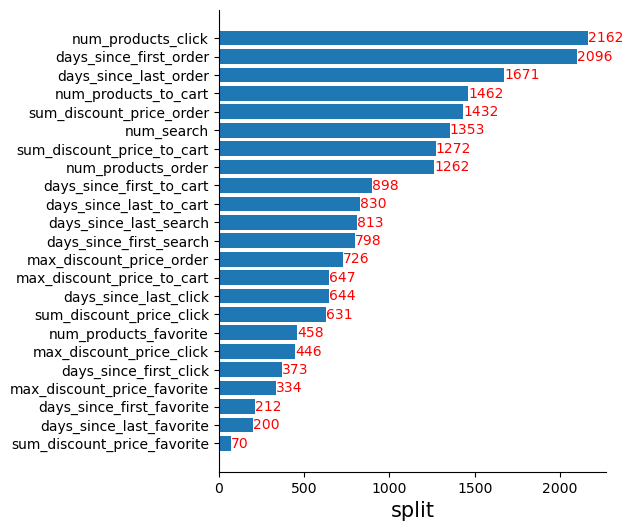

In [ ]:
from local_utils import *

print('feature_importance:', model.feature_importances_, '\n')

plot_lgbm_importance(model, cols, importance_type='split', top_k=30, sklearn_style=True)

Важность фичей кластера 3, оно и понятно, был сэмпл из 300к элементов, а всего 77кк

In [ ]:
test_users_submission = (
    pl.read_csv(os.path.join(data_path, 'test_users.csv'))
)

In [ ]:
actions_aggs = {}
actions_id_to_suf = {
    1: "click",
    2: "favorite", 
    3: "order",
    5: "to_cart",
}

# Сначала соберем все агрегированные данные
all_aggs = []
numeric_features = []

for id_, suf in actions_id_to_suf.items():
    aggs = (
        actions_history
        .filter(pl.col('timestamp').dt.date() <= val_end_date)
        .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30 * 5))
        .filter(pl.col('action_type_id') == id_)
        .join(
            product_information.select('product_id', 'discount_price'),
            on='product_id',
        )
        .group_by('user_id')
        .agg(
            pl.count('product_id').cast(pl.Int32).alias(f'num_products_{suf}'),
            pl.sum('discount_price').cast(pl.Float32).alias(f'sum_discount_price_{suf}'),
            pl.max('discount_price').cast(pl.Float32).alias(f'max_discount_price_{suf}'),
            pl.max('timestamp').alias(f'last_{suf}_time'),
            pl.min('timestamp').alias(f'first_{suf}_time'),
        )
        .with_columns([
            (pl.lit(test_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),
            
            (pl.lit(test_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
        ])
    )
    
    # Сохраняем имена числовых фичей для создания полиномов
    numeric_features.extend([
        f'num_products_{suf}',
        f'sum_discount_price_{suf}', 
        f'max_discount_price_{suf}',
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
    ])
    
    actions_aggs[id_] = aggs
    all_aggs.append(aggs)

# Объединяем все агрегации по user_id с суффиксами
combined_val = all_aggs[0]
for i, agg in enumerate(all_aggs[1:], 1):
    combined_val = combined_val.join(
        agg, 
        on='user_id', 
        how='outer',
        suffix=f"_{i}"
    )

C:\Users\Admin\AppData\Local\Temp\ipykernel_43972\2116881979.py:59: DeprecationWarning:

Use of `how='outer'` should be replaced with `how='full'`.



In [ ]:
id_ = 4
suf = 'search'
actions_aggs[id_] = (
    search_history
    .filter(pl.col('action_type_id') == id_)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30 * 5))
    .group_by('user_id')
    .agg(
        # Общее количество поисков за 5 месяцев
        pl.count('search_query').cast(pl.Int32).alias(f'num_{suf}'),
        
        # Количество поисков за последний месяц (30 дней)
        pl.col('search_query')
            .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30))
            .count()
            .cast(pl.Int32)
            .alias(f'num_{suf}_last_month'),
        
        # Количество поисков за последнюю неделю (7 дней)
        pl.col('search_query')
            .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=7))
            .count()
            .cast(pl.Int32)
            .alias(f'num_{suf}_last_week'),

        #pl.col('cluster').n_unique().alias(f'num_{suf}_clusters'),
        #pl.col('cluster').mode().first().alias(f'main_{suf}_cluster'),
        
        
        # Временные метки
        pl.max('timestamp').alias(f'last_{suf}_time'),
        pl.min('timestamp').alias(f'first_{suf}_time'),
    )
    .with_columns([
        (pl.lit(test_start_date) - pl.col(f'last_{suf}_time'))
        .dt.total_days()
        .cast(pl.Int32)
        .alias(f'days_since_last_{suf}'),

        (pl.lit(test_start_date) - pl.col(f'first_{suf}_time'))
        .dt.total_days()
        .cast(pl.Int32)
        .alias(f'days_since_first_{suf}'),
    ])
    .select(
        'user_id',
        f'num_{suf}',                # Всего поисков за 5 месяцев
        f'num_{suf}_last_month',     # Поисков за последний месяц
        f'num_{suf}_last_week',      # Поисков за последнюю неделю
        #f'num_{suf}_clusters',       # Количество уникальных кластеров (добавлено)
        #f'main_{suf}_cluster',       # Основной кластер (добавлено)
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
    )
)

In [ ]:
df_main = test_users_submission
for _, actions_aggs_df in actions_aggs.items():
    df_main = (
        df_main
        .join(actions_aggs_df, on='user_id', how='left')
    )

In [ ]:
df_pd = df_main.to_pandas()

In [ ]:
from local_utils import *

df_pd = add_polynomial_features_pd(df_pd, num_cols, degree=3)

c:\Users\Admin\Desktop\AIM 2сем\ML2\hw2\local_utils.py:626: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\Admin\Desktop\AIM 2сем\ML2\hw2\local_utils.py:630: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\Admin\Desktop\AIM 2сем\ML2\hw2\local_utils.py:631: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe 

In [ ]:
df_pd['predict'] = model.predict_proba(df_pd[cols])[:, 1]

C:\Users\Admin\AppData\Local\Temp\ipykernel_43972\925281912.py:1: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [ ]:
df_pd[['user_id', 'predict']]

,user_id,predict
0,1342,0.165687
1,9852,0.756826
2,10206,0.217988
3,11317,0.212718
4,13289,0.570717
...,...,...
2068419,11157283,0.220720
2068420,11160395,0.151001
2068421,11165052,0.596134
2068422,11168218,0.507931


In [ ]:
df_pd[['user_id', 'predict']].to_csv('res.csv', index=False)

# Другой подход к кластеризации

Пробуем новую идею, если не получается кластеризовать все обьекты, будем делать так: мы же уже знаем какие есть кластеры, просто раздадим метки по ключевым словам, олценим сколько осталось и проведем еще одну кластеризацию. 

In [ ]:
import polars as pl
import pandas as pd
import numpy as np
import catboost
import os
from datetime import date, timedelta
from itertools import combinations

from local_utils import *
import lightgbm as lgb

%load_ext autoreload
%autoreload 2

test_start_date = date(2024, 8, 1)
val_start_date = date(2024, 7, 1)
val_end_date = date(2024, 7, 31)
train_end_date = date(2024, 6, 30)
data_path = "C:\\Users\\Admin\\Desktop\\AIM 2сем\\ML2\\hw2"

actions_history = pl.scan_parquet(os.path.join(data_path, 'actions_history/*.parquet')).collect()
search_history = pl.scan_parquet(os.path.join(data_path, 'search_history/*.parquet')).collect()
product_information = pl.read_csv(
    os.path.join(data_path, 'product_information.csv'),
    ignore_errors=True
)

val_target = (
    actions_history
    .filter(pl.col('timestamp').dt.date() >= val_start_date)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .select('user_id', (pl.col('action_type_id') == 3).alias('has_order'))
    .group_by('user_id')
    .agg(pl.max('has_order').cast(pl.Int32).alias('target'))
)

val_target.group_by('target').agg(pl.count('user_id'))

sh_topd = search_history.to_pandas()
sh_topd

sh_topd = sh_topd.dropna(subset=['search_query'])

In [ ]:
sh_topd['cluster'] = -1

In [ ]:
sh_topd

,user_id,timestamp,search_query,action_type_id,widget_name_id,cluster
0,1403825,2024-03-02 19:16:19,колонка алиса,4,23,-1
1,10278224,2024-07-29 12:10:06,батончик,4,23,-1
2,8162261,2024-04-24 06:27:10,hipp combiotic 1,4,23,-1
3,10909038,2024-07-12 04:00:02,бриошь,4,23,-1
4,9148523,2024-04-28 06:58:12,нарезка,4,23,-1
...,...,...,...,...,...,...
78160840,3880979,2024-05-04 18:05:58,томатная паста,4,24,-1
78160841,666694,2024-07-10 08:56:41,пижама женская с шортами,4,24,-1
78160842,2346229,2024-03-06 06:30:44,кровать 120 на 190,4,24,-1
78160843,2455590,2024-06-27 20:52:21,пита,4,24,-1


In [ ]:
#1
milk = ['кефир', 'сметан', 'масло', 'йогурт', 'морожен', 'яйц', 'молок', 'сливк', 'ряжен', 'простокваш', 'пахт', 'сгущенк', 'сыворот', 'exponenta',
        'молоч', 'творо', 'экспонента'
]
#2
sweet = ['конфет', 'мармелад', 'сироп', 'энергетик', 'кекс', 'сахар', 'шоколад', 'батончик', 'варен', 'печень', 'торт', 'чипс', 'лейс', 'lays', 'халв', 
         'зефир', 'пастил', 'пряник', 'леден', 'драже', 'карамел', 'джем', 'мед', 'вафл', 'хлебец', 'семечки', 'киндер', 'хлопья', 'попкорн','сухар',
         'какао', 'слад', 'kinder', 'ролл', 'нори', 'сникерс', 'рождения', 'жвачка', 'bombbar', 'адреналин', 'десерт', 'суш', 
]
#3
cereals = ["греч", "рис", "овсян", "пшен", "перлов", "манк", "кукурузн", "ячнев", "булгур", "киноа", "макарон", "спагетт", "лапш", "вермишел", "фасол", 
           "горох", "нут", "чечевиц", "полб", 'каша', 'доширак', 'геркулес', 'хумус', 'завтрак', 'barilla', 'гранола', 'мюс', 
           
]
#4
veg_and_fruits = ['изюм', 'перец', 'огур', 'помидор', 'шампиньон', 'банан', 'фрукт', 'овощ', 'апельсин', 
                  'томат', 'свекл', 'баклажан', 'мандарин', 'ягод', 'гриб', 'лимон', 'персик', 'цукин', 
                  'яблок', 'груш', 'салат', 'черри', 'морков', 'патиссон', 'картош', 'картоф','капуст',
                  'груша', 'персик', 'апельсин', 'мандарин', 'баклажан', 'лук', 'авокадо', 'клубник', 
                  'зелен', 'кукуруз', 'орех', 'арбуз', 'продукт', 'оливк', 'череш', 'манго', 'шпинат',
                  'голуби', 'виноград', 'брокколи', 'сельдер', 'кабач', 'малин', 'киви', 'редис', 'фисташк', 
                  'лайм', 'маслин', 'семен', 'свеж', 'айсберг', 'азбук', 'арахис', 'fresh', 'финик', 'вишн', 
                  'спарж', 'щавель', 'ананас', 'тыкв', 
]
#5
drink = ['квас', 'сок', 'вод', 'кофе', 'чай', 'лимонад', 'напитк', 'кола', 'пиво', 'напиток', 'лед', 'коктейль'
         'святой', 'источник', 'боржоми', 'морс', 'cola', 'шишкин', 'лес', 'черноголов', 'тоник', 'липтон', 'рычал', 
         'тархун', 'вино', 
]
#6
bread = ['хлеб', 'булк', 'батон', 'багет', 'еда', 'мука', 'пицца', 'лаваш', 'тесто', 'кулич', 'пирожное', 'блин', 'круассан', 'пудинг', 'чиабатта', 
        'сушк', 'пирог', 'пасх', 'рулет', 'выпеч', 'дрожж', 'бургер', 'чизкейк', 
]
#7
cheese = ['сыр', 'брынз', 'моцарел', 'пармезан']
#8
pets = ['корм', 'наполнит', 'лакомств', 'вискас', 'педигри', 'собак', 'кошек', 'кроликов']
#9
meat = ['рыб', 'сосис', 'колбас', 'куриц', 'филе', 'говядин', 'мяс', 'крабов', 'креветк', 'свинин', 'фарш', 'кальмар', 'ветчина', 'пельмени', 'бекон'
        'индейка', 'котлет', 'суп', 'икр', 'груд', 'индейка', 'курин', 'мираторг', 'бекон', 'протеин', 'стейк', 'шашлык', 'тунец', 'форель', 'наггетсы',
        'бедро', 'индилайт', 'нарезк', 'ребр', 'голен', 'консерв', 'лосос', 'фрикадел', 'семг', 'рамен', 'халяль', 'сало', 'сельдь', 'горячая', 'сардель', 
        'тушен', 'онигири', 'свин', 'мидии', 'утк', 
]
#10
household = ['мыл', 'гел', 'паст', 'туалетн', 'крем', 'средств', 'краск', 'стакан', 'волос', 'шампун', 'кондиционер', 'салфетк', 'порошок', 'жидкост', 
             'капсул', 'бумаг', 'бумаж', 'полотен', 'проклад', 'дезодорант', 'батарейки', 'пакет', 'презервативы', 'ватные', 'диски', 'горошек', 'подар',
            'тампоны', 'комаров', 'швабра', 'свечи', 'посуда', 'сковород', 'однораз', 'пищев', 'стол', 'скотч', 'клей', 'книг', 'пласт', 'карт', 'подушк', 
            'отбел', 'чемодан', 'час', 'фольга', 'матрас', 'тетрад', 'доместос', 'удлинитель', 'резинк', 'кукл', 'уголь', 'кружк', 
]

#11
kids = ['подгузник', 'памперс', 'дет', 'соск', 'пюре', 'агуша', 'фрутоняня', 'лего', 'lego', 'игра', 'смес', 'биолакт', 'шарик', 'тема']
#12
clothing = [
    'куртк', 'пальт', 'пуховик', 'ветровк', 'плащ', 'шуб', 'дубленк', 'зимн', 'демисезонн',
    'футболк', 'рубашк', 'блузк', 'водолазк', 'толстовк', 'свитер', 'джемпер', 'кардиган', 'худи',
    'кофт', 'боди', 'топ', 'майк',
    'брюк', 'джинс', 'штан', 'штаны', 'леггинс', 'бридж', 'капри', 'юбк', 'сарафан', 'комбинезон',
    'плать', 'сарафан', 'туник', 'сарафан',
    'трусы', 'трусики', 'бюстгальтер', 'лифчик', 'белье', 'пижам', 'ночн', 'халат', 'комплект',
    'спортивн', 'лосин', 'велосипедк', 'термобелье', 'олимпийк', 'тренировочн', 'спорткостюм',
    'купальник', 'бикини', 'плавк', 'монокини', 'танкини', 'пляжн',
    'шапк', 'кепк', 'шляп', 'панам', 'косынк', 'бандан', 'берет',
    'туфл', 'кроссовк', 'ботинк', 'сапог', 'босоножк', 'сандал', 'угг', 'каблук', 'мокасин', 'лофер',
    'черепик', 'кед', 'балетк', 'сабо', 'дутик',
    'ремен', 'пояс', 'галстук', 'бабочк', 'шарф', 'перчатк', 'варежк', 'зонт', 'очк', 'солнцезащитн',
    'сумк', 'рюкзак', 'клатч', 'кошельк', 'портфель',
    'халат', 'униформа', 'спецовк', 'комбинезон', 'фартук',
    'детск', 'малыш', 'подросток', 'распашонк', 'ползунк', 'пеленк',
    'нос', 'гольф', 'чулк', 'колготк', 'подследник',
    'аксессуар', 'декор', 'украшен', 'бижутери', 'стильн', 'модн', 'брендов', 'одежда', 'шорт', 'легинс'
]
#13
health = [
    # Органы и системы
    'глаз', 'зрен', 'офтальм', 'зрит', 'сетчатк', 'роговиц',
    'сердц', 'карди', 'гипертон', 'давлен', 'пульс', 'аритм',
    'печен', 'гепат', 'желч', 'желуд', 'гастр', 'кишечн', 'панкреат',
    'почк', 'нефр', 'мочевой', 'цистит', 'простат',
    'легк', 'пневм', 'бронх', 'астм', 'кашел', 'насморк', 'горл', 'отит',
    'зуб', 'стомат', 'десн', 'кариес', 'флюс',
    'кож', 'дермат', 'акне', 'псориаз', 'экзем', 'аллерг',
    'нерв', 'неврол', 'головн', 'мигрен', 'инсульт', 'эпилепс',
    'сустав', 'артр', 'остеохондр', 'позвон', 'ревмат', 'артрит',
    'щитовид', 'эндокрин', 'диабет', 'гормон', 'инсулин',
    
    # Препараты и формы выпуска
    'таблетк', 'капсул', 'капл', 'маз', 'крем', 'гел', 'спрей', 'ингалятор',
    'суспенз', 'сироп', 'настойк', 'экстракт', 'назол', 'отинум',
    'антибиот', 'противовирусн', 'антигистаминн', 'анальгин', 'парацетамол',
    'ибупрофен', 'спазмолгон', 'но-шп', 'корвалол', 'валидол',
    'витамин', 'минерал', 'омега', 'магн', 'коллаген', 'пробиот',
    
    # Симптомы и состояния
    'бол', 'воспален', 'отек', 'опухол', 'зуд', 'жжен', 'тошнот', 'рвот',
    'диаре', 'запо', 'метеоризм', 'слабост', 'усталост', 'стресс', 'депресс',
    'бессонн', 'тревожн', 'паническ', 'судорог', 'свист', 'хрип',
    'кровоточивост', 'кров', 'гемоглоб', 'анеми', 'варикоз', 'геморро', 'линзы'
]
#14
sauces = [
    'майонез', 'кетчуп', 'горчиц', 'аджик', 'хрен', 'соус', 'тартар', 'бешамель', 'песто', 'цезар','барбекю', 'чили', 'терияк', 'сальса', 'гуакамоле',
    'сметанн', 'чесночн', 'имбирн', 'устричн', 'рыбн','ткемал', 'кисло-сладк', 'бальзамик', 'вустершир', 'карри','сырн', 'шашлычн', 'гриль', 'паприк', 'чеддер',
    'провансаль', 'брусничн', 'клюквен', 'мятн', 'укропн', 'уксус', 'приправ', 'сода'
]
#15
gadgets = [
    'смартфон', 'iphone', 'андроид', 'телефон', 'кнопочный телефон', 'раскладушка',
    'xiaomi', 'samsung', 'honor', 'huawei', 'nokia', 'realme', 'oppo', 'vivo',
    'планшет', 'ipad', 'электронная книга', 'электронная читалка', 'букридер',
    'ноутбук', 'ультрабук', 'macbook', 'asus', 'lenovo', 'hp', 'dell', 'acer', 'msi',
    'компьютер', 'системный блок', 'моноблок', 'неттоп',
    'клавиатура', 'мышь', 'мышка', 'коврик для мыши', 'трекпад', 'стилус', 'графический планшет',
    'веб-камера', 'микрофон', 'док-станция',
    'процессор', 'видеокарта', 'оперативная память', 'ssd', 'жесткий диск', 'hdd',
    'материнская плата', 'блок питания', 'охлаждение', 'кулер', 'термопаста',
    'наушники', 'airpods', 'гарнитура', 'беспроводные наушники', 'накладные наушники',
    'вкладыши', 'вакуумные', 'колонка', 'динамик', 'bluetooth колонка', 'портативная колонка',
    'микрофон', 'звуковая карта', 'dac', 'усилитель',
    'умные часы', 'smart watch', 'фитнес-браслет', 'умный браслет', 'пульсометр',
    'шагомер', 'gps трекер', 'умное кольцо',
    'чехол', 'защитное стекло', 'плёночка', 'бампер', 'держатель', 'попсокет',
    'кардхолдер', 'кабель', 'зарядка', 'адаптер', 'power bank', 'повербанк',
    'кабель usb', 'кабель type-c', 'lightning', 'переходник', 'разветвитель',
    'подставка', 'держатель для телефона', 'автодержатель',
    'игровая мышь', 'игровая клавиатура', 'джойстик', 'геймпад', 'руль', 'педали',
    'аркадный стик', 'vr', 'виртуальная реальность', 'очки vr', 'гарнитура vr',
    'фотоаппарат', 'зеркалка', 'беззеркалка', 'экшн-камера', 'go pro', 'объектив',
    'штатив', 'монопод', 'стабилизатор', 'гимбал', 'квадрокоптер', 'дрон',
    'умная лампа', 'умная розетка', 'умный дом', 'датчик', 'сенсор', 'камера наблюдения',
    'видеоняня', 'умный замок', 'робот-пылесос', 'умный термостат',
    'принтер', 'сканер', 'ксерокс', 'мфу', 'факс', 'ламинтор', 'брошюровщик',
    'уничтожитель бумаг', 'шредер',
    'электроника', 'гаджет', 'новинка', 'аксессуар', 'комплектующая', 'устройство',
    'беспроводной', 'bluetooth', 'wi-fi', 'usb', 'type-c', 'lightning', 'адаптер', 'вентилятор'
    'паштет', 'айфон', 'увлаж', 'освеж', 'пылесос', 'pro', 'холодильник', 'су вид', 'телевизор', 
    'блендер', 'весы', 
    
]
#18
spices = [
    'перец', 'соль', 'паприк', 'куркум', 'кориандр', 'кардамон', 'имбир', 
    'чеснок', 'лук', 'лавров', 'розмарин', 'тимьян', 'базилик', 'орегано', 
    'шалфей', 'мята', 'укроп', 'петрушк', 'кинз', 'тмин', 'зир', 'кориц', 
    'гвоздик', 'мускат', 'ванил', 'шафран', 'горчиц', 'хрен', 'карри', 
    'прованс', 'фенхел', 'анис', 'кумин', 'чили', 'бадьян', 'кайен',
    'хмел', 'цикор', 'том ям', 
]
#19
woman = ['женск', 'букет']

#20
man = ['мужск']

In [ ]:
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(milk), case=False, na=False), 'cluster'] = 1
print('1 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(sweet), case=False, na=False), 'cluster'] = 2
print('2 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(cereals), case=False, na=False), 'cluster'] = 3
print('3 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(veg_and_fruits), case=False, na=False), 'cluster'] = 4
print('4 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(drink), case=False, na=False), 'cluster'] = 5
print('5 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(bread), case=False, na=False), 'cluster'] = 6
print('6 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(cheese), case=False, na=False), 'cluster'] = 7
print('7 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(pets), case=False, na=False), 'cluster'] = 8
print('8 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(meat), case=False, na=False), 'cluster'] = 9
print('9 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(household), case=False, na=False), 'cluster'] = 10
print('10 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(kids), case=False, na=False), 'cluster'] = 11
print('11 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(clothing), case=False, na=False), 'cluster'] = 12
print('12 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(health), case=False, na=False), 'cluster'] = 13
print('13 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(sauces), case=False, na=False), 'cluster'] = 14
print('14 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(gadgets), case=False, na=False), 'cluster'] = 15
print('15 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('для', case=False, na=False), 'cluster'] = 16
print('16 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('цвет', case=False, na=False), 'cluster'] = 17
print('17 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(spices), case=False, na=False), 'cluster'] = 18
print('18 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(woman), case=False, na=False), 'cluster'] = 19
print('19 finished')
sh_topd.loc[sh_topd['search_query'].str.contains('|'.join(man), case=False, na=False), 'cluster'] = 20
print('20 finished')


remaining_negatives = (sh_topd['cluster'] == -1).sum()
print(f"Осталось строк с меткой -1: {remaining_negatives}")

1 finished
2 finished
3 finished
4 finished
5 finished
6 finished
7 finished
8 finished
9 finished
10 finished
11 finished
12 finished
13 finished
14 finished
15 finished
16 finished
17 finished
18 finished
Осталось строк с меткой -1: 23932935


In [ ]:
import pandas as pd
from collections import Counter

sh_topd_filtered = sh_topd[sh_topd['cluster'] == -1].copy()

all_words = []
for query in sh_topd_filtered['search_query']:
    words = query.split()
    all_words.extend(words)

unique_words = set(all_words)

word_counts = Counter(all_words)

word_counts_df = pd.DataFrame.from_dict(word_counts, orient='index', columns=['count']).sort_values('count', ascending=False)

print(f"Всего уникальных слов: {len(unique_words)}")
print("Топ-10 самых частых слов:")
print(word_counts_df.head(25))
#print(word_counts_df.iloc[24:50])

In [ ]:
print(word_counts_df.iloc[75:100])

             count
страчателла  22884
айран        22794
лепешка      22729
петелинка    22682
милка        22647
чупа         22502
маска        22441
белок        22281
барни        22106
маскарпоне   22035
по           21798
моти         21691
кешью        21667
мг           21501
фета         21408
добрый       21367
актимель     21244
коврик       21122
доска        20950
желе         20942
сигареты     20879
скумбрия     20817
эклеры       20717
фунчоза      20403
глютена      20289


15310220

In [ ]:
remaining_negatives = (sh_topd['cluster'] == -1).sum()
print(f"Осталось строк с меткой -1: {remaining_negatives}")

Осталось строк с меткой -1: 13931972


In [ ]:
sh_topd

,user_id,timestamp,search_query,action_type_id,widget_name_id,cluster
0,1403825,2024-03-02 19:16:19,колонка алиса,4,23,15
1,10278224,2024-07-29 12:10:06,батончик,4,23,6
2,8162261,2024-04-24 06:27:10,hipp combiotic 1,4,23,-1
3,10909038,2024-07-12 04:00:02,бриошь,4,23,-1
4,9148523,2024-04-28 06:58:12,нарезка,4,23,9
...,...,...,...,...,...,...
78160840,3880979,2024-05-04 18:05:58,томатная паста,4,24,10
78160841,666694,2024-07-10 08:56:41,пижама женская с шортами,4,24,19
78160842,2346229,2024-03-06 06:30:44,кровать 120 на 190,4,24,13
78160843,2455590,2024-06-27 20:52:21,пита,4,24,-1


In [ ]:
import os
import pandas as pd
import polars as pl 

sh_topl = pl.from_pandas(sh_topd)

output_dir = "cluster_search"
os.makedirs(output_dir, exist_ok=True)

chunk_size = 1_000_000  

num_chunks = len(sh_topl) // chunk_size + 1  

for i in range(num_chunks):
    start_idx = i * chunk_size
    end_idx = (i + 1) * chunk_size
    chunk = sh_topl[start_idx:end_idx]
    
    chunk.write_parquet(f"{output_dir}/cluster_search_part_{i}.parquet") 

In [ ]:
cluster_search = pl.scan_parquet(os.path.join(data_path, 'cluster_search/*.parquet')).collect()

In [ ]:
cluster_search

user_id,timestamp,search_query,action_type_id,widget_name_id,cluster
i32,datetime[ns],str,i8,i8,i64
1403825,2024-03-02 19:16:19,"""колонка алиса""",4,23,15
10278224,2024-07-29 12:10:06,"""батончик""",4,23,6
8162261,2024-04-24 06:27:10,"""hipp combiotic 1""",4,23,-1
10909038,2024-07-12 04:00:02,"""бриошь""",4,23,-1
9148523,2024-04-28 06:58:12,"""нарезка""",4,23,9
…,…,…,…,…,…
7807844,2024-03-05 13:47:01,"""протеиновый шейк""",4,2,9
1366466,2024-06-25 08:57:35,"""для укладки волос""",4,2,16
6541667,2024-07-10 10:30:42,"""макароны гнезда""",4,2,3


In [ ]:
sh_topd_filtered = sh_topd[sh_topd['cluster'] == -1].copy()
cluster_search_queries(sh_topd_filtered, 'search_query', 100_000)

In [ ]:
import polars as pl
import pandas as pd
import numpy as np
import catboost
import os
from datetime import date, timedelta
from itertools import combinations

from local_utils import *
import lightgbm as lgb

%load_ext autoreload
%autoreload 2


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
test_start_date = date(2024, 8, 1)
val_start_date = date(2024, 7, 1)
val_end_date = date(2024, 7, 31)
train_end_date = date(2024, 6, 30)
data_path = "C:\\Users\\Admin\\Desktop\\AIM 2сем\\ML2\\hw2"

In [ ]:
actions_history = pl.scan_parquet(os.path.join(data_path, 'actions_history/*.parquet')).collect()
search_history = pl.scan_parquet(os.path.join(data_path, 'search_history/*.parquet')).collect()
product_information = pl.read_csv(
    os.path.join(data_path, 'product_information.csv'),
    ignore_errors=True
)

In [ ]:
val_target = (
    actions_history
    .filter(pl.col('timestamp').dt.date() >= val_start_date)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .select('user_id', (pl.col('action_type_id') == 3).alias('has_order'))
    .group_by('user_id')
    .agg(pl.max('has_order').cast(pl.Int32).alias('target'))
)

In [ ]:
val_target.group_by('target').agg(pl.count('user_id'))

target,user_id
i32,u32
0,1227381
1,647575


In [ ]:
actions_aggs = {}
actions_id_to_suf = {
    1: "click",
    2: "favorite", 
    3: "order",
    5: "to_cart",
}

# Сначала соберем все агрегированные данные
all_aggs = []
numeric_features = []

for id_, suf in actions_id_to_suf.items():
    aggs = (
        actions_history
        .filter(pl.col('timestamp').dt.date() <= train_end_date)
        .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30 * 4))
        .filter(pl.col('action_type_id') == id_)
        .join(
            product_information.select('product_id', 'discount_price'),
            on='product_id',
        )
        .group_by('user_id')
        .agg(
            pl.count('product_id').cast(pl.Int32).alias(f'num_products_{suf}'),
            pl.sum('discount_price').cast(pl.Float32).alias(f'sum_discount_price_{suf}'),
            pl.max('discount_price').cast(pl.Float32).alias(f'max_discount_price_{suf}'),
            pl.max('timestamp').alias(f'last_{suf}_time'),
            pl.min('timestamp').alias(f'first_{suf}_time'),
        )
        .with_columns([
            (pl.lit(val_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),
            
            (pl.lit(val_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
        ])
    )
    
    # Сохраняем имена числовых фичей для последующего создания полиномов
    numeric_features.extend([
        f'num_products_{suf}',
        f'sum_discount_price_{suf}', 
        f'max_discount_price_{suf}',
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
    ])
    
    actions_aggs[id_] = aggs
    all_aggs.append(aggs)

# Объединяем все агрегации по user_id с указанием суффиксов
combined = all_aggs[0]
for i, agg in enumerate(all_aggs[1:], 1):
    combined = combined.join(
        agg, 
        on='user_id', 
        how='left',
        suffix=f"_{i}"  # Добавляем уникальный суффикс для каждого соединения
    )

In [ ]:
if 1 and (not isinstance(sh_topd, pl.DataFrame)):
    sh_topd = pl.from_pandas(sh_topd)  # Конвертируем pandas -> polars

    # Ключи для объединения
    join_keys = ['user_id', 'timestamp', 'search_query']

    # Выполняем left join
    search_history = search_history.join(
        sh_topd.select(join_keys + ['cluster']),  # Выбираем нужные колонки
        on=join_keys,
        how='left'
    )
    
# search_aggs
id_ = 4
suf = 'search'

# Сначала вычислим value_counts отдельно и развернем их в плоскую структуру
cluster_counts = (
    search_history
    .filter(pl.col('action_type_id') == id_)
    .filter(pl.col('timestamp').dt.date() <= train_end_date)
    .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30 * 5))
    .group_by('user_id')
    .agg(
        pl.col('cluster').value_counts().alias('cluster_counts')
    )
    .explode('cluster_counts')
    .with_columns(
        pl.col('cluster_counts').struct.field('cluster').alias('cluster_name'),
        pl.col('cluster_counts').struct.field('count').alias('cluster_count')
    )
    .group_by('user_id')
    .agg(
        pl.col('cluster_name').sort_by('cluster_count', descending=True).head(3).alias('top3_clusters'),
        pl.col('cluster_count').sort(descending=True).head(3).alias('top3_counts')
    )
)

actions_aggs[id_] = (
    search_history
    .filter(pl.col('action_type_id') == id_)
    .filter(pl.col('timestamp').dt.date() <= train_end_date)
    .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30 * 5))
    .group_by('user_id')
    .agg(
        # Общее количество поисков за 5 месяцев
        pl.count('search_query').cast(pl.Int32).alias(f'num_{suf}'),
        pl.col('search_query').n_unique().alias(f'unique_{suf}_queries'),
        
        # Количество поисков за последний месяц (30 дней)
        pl.col('search_query')
            .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30))
            .count()
            .cast(pl.Int32)
            .alias(f'num_{suf}_last_month'),
        
        # Количество поисков за последнюю неделю (7 дней)
        pl.col('search_query')
            .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=7))
            .count()
            .cast(pl.Int32)
            .alias(f'num_{suf}_last_week'),

        (pl.count() / (pl.max('timestamp') - pl.min('timestamp')).dt.total_days()).alias(f'{suf}_daily_rate'),

        pl.col('cluster').n_unique().alias(f'num_{suf}_clusters'),
        pl.col('cluster').mode().first().alias(f'main_{suf}_cluster'),
        
        # Динамика кластеров
        pl.col('cluster')
            .filter(pl.col('timestamp').dt.date() >= train_end_date - timedelta(days=30))
            .mode().first()
            .alias(f'recent_{suf}_cluster'),

        (pl.col('cluster').value_counts().struct.field('count').max() / pl.col('cluster').count()).alias(f'{suf}_cluster_concentration'),
        
        # Энтропия кластеров (мера разнообразия)
        (-(pl.col('cluster').value_counts().struct.field('count') / pl.col('cluster').count()).log()
            * (pl.col('cluster').value_counts().struct.field('count') / pl.col('cluster').count())
            .sum()).alias(f'{suf}_cluster_entropy'),
        
        # Переключения между кластерами
        pl.col('cluster').diff().fill_null(0).abs().sum().alias(f'{suf}_cluster_switches'),
        
        # Стабильность кластеров (процент повторяющихся)
        ((pl.col('cluster').count() - pl.col('cluster').n_unique()) / pl.col('cluster').count())
            .alias(f'{suf}_cluster_stability'),
        
        # Время в основном кластере
        (pl.col('timestamp')
            .filter(pl.col('cluster') == pl.col('cluster').mode().first())
            .count() / pl.col('timestamp').count())
            .alias(f'main_{suf}_cluster_time_ratio'),

        pl.col('timestamp').filter(pl.col('cluster').diff().fill_null(0) != 0)
            .diff()
            .dt.total_days()
            .mean()
            .alias(f'{suf}_mean_cluster_switch_days'),

        pl.col('search_query').str.len_chars().mean().alias(f'{suf}_mean_query_len'),
        
        (pl.col('search_query').str.len_chars()
            .filter(pl.col('cluster') == pl.col('cluster').mode().first()).mean() - 
            pl.col('search_query').str.len_chars()
                .filter(pl.col('cluster') != pl.col('cluster').mode().first()).mean())
                .alias(f'{suf}_main_cluster_query_len_diff'),

        pl.max('timestamp').alias(f'last_{suf}_time'),
        pl.min('timestamp').alias(f'first_{suf}_time'),
    )
    .join(cluster_counts, on='user_id', how='left')
    .with_columns([
        (pl.lit(val_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),

        (pl.lit(val_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
    ])
    .select(
        'user_id',
        f'num_{suf}',
        f'unique_{suf}_queries',
        f'num_{suf}_last_month',
        f'num_{suf}_last_week',
        f'{suf}_daily_rate',
        f'num_{suf}_clusters',
        f'main_{suf}_cluster',
        pl.col('top3_clusters').alias(f'top3_{suf}_clusters'),
        pl.col('top3_counts').alias(f'top3_{suf}_counts'),
        f'recent_{suf}_cluster',
        f'{suf}_cluster_concentration',
        f'{suf}_cluster_entropy',
        f'{suf}_cluster_switches',
        f'{suf}_cluster_stability',
        f'main_{suf}_cluster_time_ratio',
        f'{suf}_mean_cluster_switch_days',
        f'{suf}_mean_query_len',
        f'{suf}_main_cluster_query_len_diff',
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
        f'last_{suf}_time',
        f'first_{suf}_time',
    )
)

C:\Users\Admin\AppData\Local\Temp\ipykernel_55732\2598437039.py:65: DeprecationWarning:

`pl.count()` is deprecated. Please use `pl.len()` instead.



In [ ]:
df_main = val_target
for _, actions_aggs_df in actions_aggs.items():
    df_main = (
        df_main
        .join(actions_aggs_df, on='user_id', how='left')
    )
    
df_pd = df_main.to_pandas()

num_cols = ['num_products_click', 'sum_discount_price_click', 'max_discount_price_click', 'days_since_last_click', 'days_since_first_click', 
    'num_products_favorite', 'sum_discount_price_favorite', 'max_discount_price_favorite', 'days_since_last_favorite', 
    'days_since_first_favorite', 'num_products_order', 'sum_discount_price_order', 'max_discount_price_order', 'days_since_last_order', 
    'days_since_first_order', 'num_products_to_cart', 'sum_discount_price_to_cart', 'max_discount_price_to_cart', 'days_since_last_to_cart', 
    'days_since_first_to_cart']

In [ ]:
from local_utils import *

df_pd = add_polynomial_features_pd(df_pd, num_cols, degree=3)

df_pd = df_pd[df_pd['user_id'] != 2346229]

tr, val = get_split(df_pd, val_size=0.3)

cols = [
    # Существующие столбцы
    'num_products_click', 
    'sum_discount_price_click', 'max_discount_price_click',
    'days_since_last_click', 'days_since_first_click',
    'num_products_favorite', 'sum_discount_price_favorite',
    'max_discount_price_favorite', 'days_since_last_favorite',
    'days_since_first_favorite', 'num_products_order',
    'sum_discount_price_order', 'max_discount_price_order',
    'days_since_last_order', 'days_since_first_order',
    'num_products_to_cart', 'sum_discount_price_to_cart',
    'max_discount_price_to_cart', 'days_since_last_to_cart',
    'days_since_first_to_cart', 'num_search', 'days_since_last_search',
    'days_since_first_search', 
    'main_search_cluster', 'num_search_clusters',
    
    # Новые столбцы из анализа поиска
    'unique_search_queries',               # Количество уникальных поисковых запросов
    'num_search_last_month',               # Поисков за последний месяц
    'num_search_last_week',                # Поисков за последнюю неделю
    'search_daily_rate',                   # Среднедневная частота поисков
    'recent_search_cluster',               # Последний доминирующий кластер
    'search_cluster_concentration',        # Концентрация интересов
    'search_cluster_switches',             # Переключения между кластерами
    'search_cluster_stability',            # Стабильность кластеров
    'main_search_cluster_time_ratio',      # Время в основном кластере
    'search_mean_cluster_switch_days',     # Среднее время между сменами кластеров
    'search_mean_query_len',               # Средняя длина запроса
    'search_main_cluster_query_len_diff',  # Разница длины запросов
]

params={
        'objective': 'binary',
        'metric': 'auc',
        'learning_rate': 0.01,
        'max_depth': 100,
        'num_iterations': 700,
        'early_stopping_rounds': 60,
        'verbose': 1,
        'importance_type': 'split'
    }

model = train_model(tr, val, cols, 'target', params=params, shadow_features=False, sklearn_style=True)


[LightGBM] [Warning] early_stopping_round is set=60, early_stopping_rounds=60 will be ignored. Current value: early_stopping_round=60
[LightGBM] [Info] Number of positive: 453686, number of negative: 858782
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.032461 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 7123
[LightGBM] [Info] Number of data points in the train set: 1312468, number of used features: 37
[LightGBM] [Warning] early_stopping_round is set=60, early_stopping_rounds=60 will be ignored. Current value: early_stopping_round=60
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.345674 -> initscore=-0.638110
[LightGBM] [Info] Start training from score -0.638110
Training until validation scores don't improve for 100 rounds
Training until validation scores don't improve for 60 rounds
Did not meet early stopping. Best iteration is:

feature_importance: [2004  492  374  457  376  392   44  256  126  153 1302 1367  626 1608
 1893 1326 1029  505  596  730  257  378  379  448  170  119  573  103
  398   93   67  646  505   48  124  779  197] 



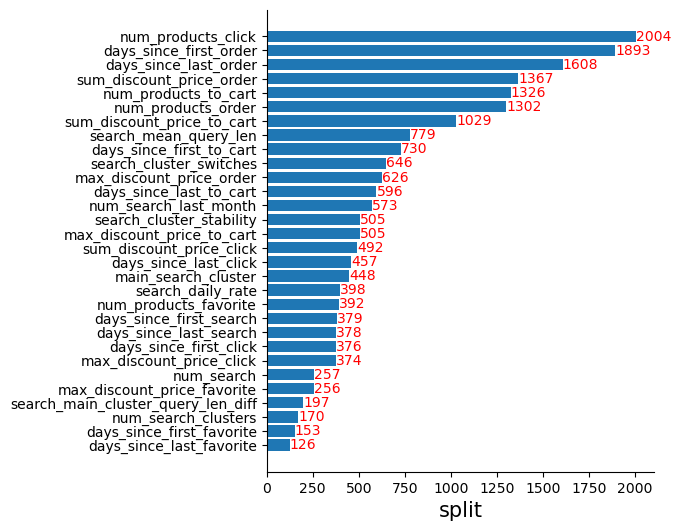

In [ ]:
from local_utils import *

print('feature_importance:', model.feature_importances_, '\n')

plot_lgbm_importance(model, cols, importance_type='split', top_k=30, sklearn_style=True)

test_users_submission = (
    pl.read_csv(os.path.join(data_path, 'test_users.csv'))
)

In [ ]:
actions_aggs = {}
actions_id_to_suf = {
    1: "click",
    2: "favorite", 
    3: "order",
    5: "to_cart",
}

# Сначала соберем все агрегированные данные
all_aggs = []
numeric_features = []

for id_, suf in actions_id_to_suf.items():
    aggs = (
        actions_history
        .filter(pl.col('timestamp').dt.date() <= val_end_date)
        .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30 * 5))
        .filter(pl.col('action_type_id') == id_)
        .join(
            product_information.select('product_id', 'discount_price'),
            on='product_id',
        )
        .group_by('user_id')
        .agg(
            pl.count('product_id').cast(pl.Int32).alias(f'num_products_{suf}'),
            pl.sum('discount_price').cast(pl.Float32).alias(f'sum_discount_price_{suf}'),
            pl.max('discount_price').cast(pl.Float32).alias(f'max_discount_price_{suf}'),
            pl.max('timestamp').alias(f'last_{suf}_time'),
            pl.min('timestamp').alias(f'first_{suf}_time'),
        )
        .with_columns([
            (pl.lit(test_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),
            
            (pl.lit(test_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
        ])
    )
    
    # Сохраняем имена числовых фичей для создания полиномов
    numeric_features.extend([
        f'num_products_{suf}',
        f'sum_discount_price_{suf}', 
        f'max_discount_price_{suf}',
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
    ])
    
    actions_aggs[id_] = aggs
    all_aggs.append(aggs)

# Объединяем все агрегации по user_id с суффиксами
combined_val = all_aggs[0]
for i, agg in enumerate(all_aggs[1:], 1):
    combined_val = combined_val.join(
        agg, 
        on='user_id', 
        how='outer',
        suffix=f"_{i}"
    )

C:\Users\Admin\AppData\Local\Temp\ipykernel_55732\2116881979.py:59: DeprecationWarning:

Use of `how='outer'` should be replaced with `how='full'`.



In [ ]:
id_ = 4
suf = 'search'

# Вычисляем top3 кластеров для валидации (аналогично трейну)
val_cluster_counts = (
    search_history
    .filter(pl.col('action_type_id') == id_)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30 * 5))
    .group_by('user_id')
    .agg(
        pl.col('cluster').value_counts().alias('cluster_counts')
    )
    .explode('cluster_counts')
    .with_columns(
        pl.col('cluster_counts').struct.field('cluster').alias('cluster_name'),
        pl.col('cluster_counts').struct.field('count').alias('cluster_count')
    )
    .group_by('user_id')
    .agg(
        pl.col('cluster_name').sort_by('cluster_count', descending=True).head(3).alias('top3_clusters'),
        pl.col('cluster_count').sort(descending=True).head(3).alias('top3_counts')
    )
)

actions_aggs[id_] = (
    search_history
    .filter(pl.col('action_type_id') == id_)
    .filter(pl.col('timestamp').dt.date() <= val_end_date)
    .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30 * 5))
    .group_by('user_id')
    .agg(
        # Общее количество поисков за 5 месяцев
        pl.count('search_query').cast(pl.Int32).alias(f'num_{suf}'),
        pl.col('search_query').n_unique().alias(f'unique_{suf}_queries'),
        
        # Количество поисков за последний месяц (30 дней)
        pl.col('search_query')
            .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30))
            .count()
            .cast(pl.Int32)
            .alias(f'num_{suf}_last_month'),
        
        # Количество поисков за последнюю неделю (7 дней)
        pl.col('search_query')
            .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=7))
            .count()
            .cast(pl.Int32)
            .alias(f'num_{suf}_last_week'),

        (pl.count() / (pl.max('timestamp') - pl.min('timestamp')).dt.total_days()).alias(f'{suf}_daily_rate'),

        pl.col('cluster').n_unique().alias(f'num_{suf}_clusters'),
        pl.col('cluster').mode().first().alias(f'main_{suf}_cluster'),
        
        # Динамика кластеров
        pl.col('cluster')
            .filter(pl.col('timestamp').dt.date() >= val_end_date - timedelta(days=30))
            .mode().first()
            .alias(f'recent_{suf}_cluster'),

        (pl.col('cluster').value_counts().struct.field('count').max() / pl.col('cluster').count()).alias(f'{suf}_cluster_concentration'),
        
        # Энтропия кластеров
        (-(pl.col('cluster').value_counts().struct.field('count') / pl.col('cluster').count()).log()
            * (pl.col('cluster').value_counts().struct.field('count') / pl.col('cluster').count())
            .sum()).alias(f'{suf}_cluster_entropy'),
        
        # Переключения между кластерами
        pl.col('cluster').diff().fill_null(0).abs().sum().alias(f'{suf}_cluster_switches'),
        
        # Стабильность кластеров
        ((pl.col('cluster').count() - pl.col('cluster').n_unique()) / pl.col('cluster').count())
            .alias(f'{suf}_cluster_stability'),
        
        # Время в основном кластере
        (pl.col('timestamp')
            .filter(pl.col('cluster') == pl.col('cluster').mode().first())
            .count() / pl.col('timestamp').count())
            .alias(f'main_{suf}_cluster_time_ratio'),

        pl.col('timestamp').filter(pl.col('cluster').diff().fill_null(0) != 0)
            .diff()
            .dt.total_days()
            .mean()
            .alias(f'{suf}_mean_cluster_switch_days'),

        pl.col('search_query').str.len_chars().mean().alias(f'{suf}_mean_query_len'),
        
        (pl.col('search_query').str.len_chars()
            .filter(pl.col('cluster') == pl.col('cluster').mode().first()).mean() - 
            pl.col('search_query').str.len_chars()
                .filter(pl.col('cluster') != pl.col('cluster').mode().first()).mean())
                .alias(f'{suf}_main_cluster_query_len_diff'),

        pl.max('timestamp').alias(f'last_{suf}_time'),
        pl.min('timestamp').alias(f'first_{suf}_time'),
    )
    .join(val_cluster_counts, on='user_id', how='left')
    .with_columns([
        (pl.lit(test_start_date) - pl.col(f'last_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_last_{suf}'),

        (pl.lit(test_start_date) - pl.col(f'first_{suf}_time'))
            .dt.total_days()
            .cast(pl.Int32)
            .alias(f'days_since_first_{suf}'),
    ])
    .select(
        'user_id',
        f'num_{suf}',
        f'unique_{suf}_queries',
        f'num_{suf}_last_month',
        f'num_{suf}_last_week',
        f'{suf}_daily_rate',
        f'num_{suf}_clusters',
        f'main_{suf}_cluster',
        pl.col('top3_clusters').alias(f'top3_{suf}_clusters'),
        pl.col('top3_counts').alias(f'top3_{suf}_counts'),
        f'recent_{suf}_cluster',
        f'{suf}_cluster_concentration',
        f'{suf}_cluster_entropy',
        f'{suf}_cluster_switches',
        f'{suf}_cluster_stability',
        f'main_{suf}_cluster_time_ratio',
        f'{suf}_mean_cluster_switch_days',
        f'{suf}_mean_query_len',
        f'{suf}_main_cluster_query_len_diff',
        f'days_since_last_{suf}',
        f'days_since_first_{suf}',
        f'last_{suf}_time',
        f'first_{suf}_time',
    )
)

C:\Users\Admin\AppData\Local\Temp\ipykernel_55732\555555092.py:51: DeprecationWarning:

`pl.count()` is deprecated. Please use `pl.len()` instead.



In [ ]:
df_main = test_users_submission
for _, actions_aggs_df in actions_aggs.items():
    df_main = (
        df_main
        .join(actions_aggs_df, on='user_id', how='left')
    )
    
df_pd = df_main.to_pandas()

In [ ]:
df_pd

,user_id,num_products_click,sum_discount_price_click,max_discount_price_click,last_click_time,first_click_time,days_since_last_click,days_since_first_click,num_products_favorite,sum_discount_price_favorite,...,search_cluster_switches,search_cluster_stability,main_search_cluster_time_ratio,search_mean_cluster_switch_days,search_mean_query_len,search_main_cluster_query_len_diff,days_since_last_search,days_since_first_search,last_search_time,first_search_time
0,1342,1.0,1213.0,1213.0,2024-04-21 15:03:11,2024-04-21 15:03:11,101.0,101.0,1.0,1213.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT,NaT
1,9852,37.0,14359.0,1985.0,2024-07-11 06:51:15,2024-03-03 10:24:47,20.0,150.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT,NaT
2,10206,NaN,NaN,NaN,NaT,NaT,NaN,NaN,NaN,NaN,...,0.0,0.000000,1.000000,NaN,16.000000,NaN,96.0,96.0,2024-04-26 20:32:33,2024-04-26 20:32:33
3,11317,NaN,NaN,NaN,NaT,NaT,NaN,NaN,NaN,NaN,...,0.0,0.000000,1.000000,NaN,21.000000,NaN,77.0,77.0,2024-05-15 12:32:51,2024-05-15 12:32:51
4,13289,NaN,NaN,NaN,NaT,NaT,NaN,NaN,NaN,NaN,...,0.0,0.000000,1.000000,NaN,35.000000,NaN,123.0,123.0,2024-03-30 04:25:24,2024-03-30 04:25:24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2068419,11157283,NaN,NaN,NaN,NaT,NaT,NaN,NaN,NaN,NaN,...,0.0,0.500000,1.000000,NaN,23.000000,NaN,7.0,7.0,2024-07-24 16:35:49,2024-07-24 16:35:38
2068420,11160395,NaN,NaN,NaN,NaT,NaT,NaN,NaN,1.0,89.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaT,NaT
2068421,11165052,9.0,2515.0,592.0,2024-07-25 22:37:15,2024-04-04 01:23:31,6.0,118.0,NaN,NaN,...,134.0,0.714286,0.214286,-6.157895,12.785714,8.121212,0.0,118.0,2024-07-31 14:27:17,2024-04-04 01:23:13
2068422,11168218,4.0,870.0,329.0,2024-06-27 18:48:23,2024-04-04 06:00:33,34.0,118.0,NaN,NaN,...,3.0,0.571429,0.500000,NaN,11.142857,3.000000,34.0,131.0,2024-06-27 18:47:51,2024-03-22 06:28:02


In [ ]:
from local_utils import *

df_pd = add_polynomial_features_pd(df_pd, num_cols, degree=3)

df_pd['predict'] = model.predict_proba(df_pd[cols])[:, 1]

c:\Users\Admin\Desktop\AIM 2сем\ML2\hw2\local_utils.py:631: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\Admin\Desktop\AIM 2сем\ML2\hw2\local_utils.py:626: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

c:\Users\Admin\Desktop\AIM 2сем\ML2\hw2\local_utils.py:630: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe 

In [ ]:
df_pd[['user_id', 'predict']]

,user_id,predict
0,1342,0.169089
1,9852,0.774888
2,10206,0.224748
3,11317,0.218412
4,13289,0.572103
...,...,...
2068419,11157283,0.207012
2068420,11160395,0.150203
2068421,11165052,0.588058
2068422,11168218,0.460919


In [ ]:
df_pd[['user_id', 'predict']].to_csv('res.csv', index=False)